## 1. Setup

In [1]:
!pip install tensorflow opencv-python matplotlib

In [2]:
import tensorflow as tf
import os
import cv2
import numpy as np
from matplotlib import pyplot as plt

In [3]:
data = tf.keras.utils.image_dataset_from_directory('data/train')

Found 5216 files belonging to 2 classes.


In [4]:
data_iterator = data.as_numpy_iterator()

In [5]:
batch = data_iterator.next()

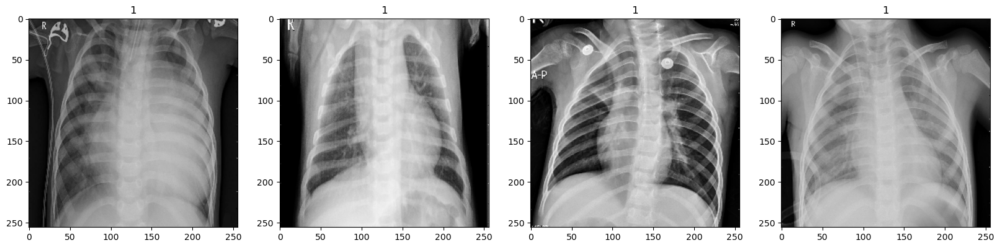

In [6]:
fig, ax = plt.subplots(ncols=4, figsize=(20,20))
for idx, img in enumerate(batch[0][:4]):
    ax[idx].imshow(img.astype(int))
    ax[idx].title.set_text(batch[1][idx])

## 2. Data Scaling and Splitting


In [7]:
data = data.map(lambda x,y: (x/255, y))

In [8]:
data.as_numpy_iterator().next()

(array([[[[7.33532459e-02, 7.33532459e-02, 7.33532459e-02],
          [1.23628981e-01, 1.23628981e-01, 1.23628981e-01],
          [1.54802397e-01, 1.54802397e-01, 1.54802397e-01],
          ...,
          [5.59129892e-03, 5.59129892e-03, 5.59129892e-03],
          [0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
          [1.76164220e-04, 1.76164220e-04, 1.76164220e-04]],
 
         [[8.81127417e-02, 8.81127417e-02, 8.81127417e-02],
          [1.28431380e-01, 1.28431380e-01, 1.28431380e-01],
          [1.49211094e-01, 1.49211094e-01, 1.49211094e-01],
          ...,
          [2.55514700e-02, 2.55514700e-02, 2.55514700e-02],
          [1.35569857e-03, 1.35569857e-03, 1.35569857e-03],
          [0.00000000e+00, 0.00000000e+00, 0.00000000e+00]],
 
         [[1.05905332e-01, 1.05905332e-01, 1.05905332e-01],
          [1.35600492e-01, 1.35600492e-01, 1.35600492e-01],
          [1.47365198e-01, 1.47365198e-01, 1.47365198e-01],
          ...,
          [5.07123172e-02, 5.07123172e-02, 5.0712

In [9]:
train_size = int(len(data)*.7)
val_size = int(len(data)*.2)
test_size = int(len(data)*.1)
train_size + val_size + test_size

162

In [10]:
train = data.take(train_size)
val = data.skip(train_size).take(val_size)
test = data.skip(train_size+val_size).take(test_size)

## 3. Building Deep Learning Model

In [11]:
train

<_TakeDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>

In [12]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Dense, Flatten, Dropout

In [13]:
model = Sequential()

In [14]:
model.add(Conv2D(16, (3,3), 1, activation='relu', input_shape=(256,256,3)))
model.add(MaxPooling2D())
model.add(Conv2D(32, (3,3), 1, activation='relu'))
model.add(MaxPooling2D())
model.add(Conv2D(16, (3,3), 1, activation='relu'))
model.add(MaxPooling2D())
model.add(Flatten())
model.add(Dense(256, activation='relu'))
model.add(Dense(1, activation='sigmoid'))


In [15]:
model.compile('adam', loss=tf.losses.BinaryCrossentropy(), metrics=['accuracy'])

In [16]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 254, 254, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2  (None, 127, 127, 16)      0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 125, 125, 32)      4640      
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 62, 62, 32)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 60, 60, 16)        4624      
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 30, 30, 16)        0

## 4. Training


In [17]:
logdir='logs'

In [18]:
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=logdir)

In [19]:
hist = model.fit(train, epochs=20, validation_data=val, callbacks=[tensorboard_callback])

Epoch 1/20
114/114 [==============================] - 112s 974ms/step - loss: 0.3449 - accuracy: 0.8572 - val_loss: 0.1371 - val_accuracy: 0.9512
Epoch 2/20
114/114 [==============================] - 443s 4s/step - loss: 0.1366 - accuracy: 0.9444 - val_loss: 0.0972 - val_accuracy: 0.9629
Epoch 3/20
114/114 [==============================] - 73s 635ms/step - loss: 0.0918 - accuracy: 0.9644 - val_loss: 0.0944 - val_accuracy: 0.9619
Epoch 4/20
114/114 [==============================] - 79s 691ms/step - loss: 0.0713 - accuracy: 0.9748 - val_loss: 0.0887 - val_accuracy: 0.9658
Epoch 5/20
114/114 [==============================] - 89s 769ms/step - loss: 0.0610 - accuracy: 0.9748 - val_loss: 0.0694 - val_accuracy: 0.9775
Epoch 6/20
114/114 [==============================] - 1494s 13s/step - loss: 0.0565 - accuracy: 0.9794 - val_loss: 0.0734 - val_accuracy: 0.9678
Epoch 7/20
114/114 [==============================] - 81s 702ms/step - loss: 0.0527 - accuracy: 0.9816 - val_loss: 0.0667 - val_acc

## 5. Performance Plotting and Evaluation

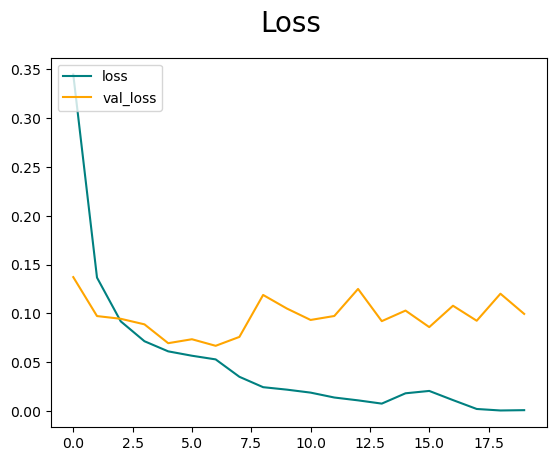

In [20]:
fig = plt.figure()
plt.plot(hist.history['loss'], color='teal', label='loss')
plt.plot(hist.history['val_loss'], color='orange', label='val_loss')
fig.suptitle('Loss', fontsize=20)
plt.legend(loc="upper left")
plt.show()

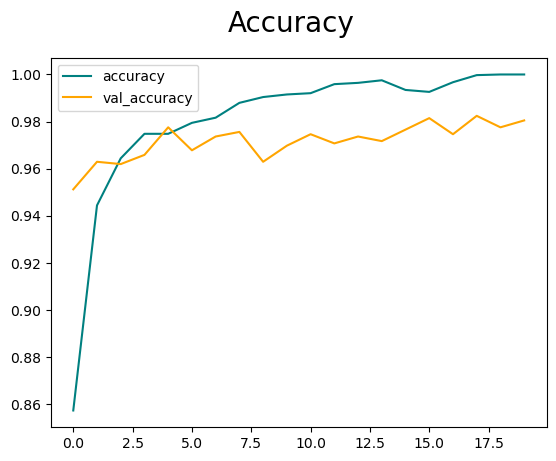

In [21]:
fig = plt.figure()
plt.plot(hist.history['accuracy'], color='teal', label='accuracy')
plt.plot(hist.history['val_accuracy'], color='orange', label='val_accuracy')
fig.suptitle('Accuracy', fontsize=20)
plt.legend(loc="upper left")
plt.show()

In [22]:
# Eval
from tensorflow.keras.metrics import Precision, Recall, BinaryAccuracy

In [23]:
pre = Precision()
re = Recall()
acc = BinaryAccuracy()

for batch in test.as_numpy_iterator(): 
    X, y = batch
    yhat = model.predict(X)
    pre.update_state(y, yhat)
    re.update_state(y, yhat)
    acc.update_state(y, yhat)

print(pre.result(), re.result(), acc.result())

1/1 [==============================] - 0s 110ms/step
tf.Tensor(0.978836, shape=(), dtype=float32) tf.Tensor(0.978836, shape=(), dtype=float32) tf.Tensor(0.96875, shape=(), dtype=float32)


# Accuracy

## Testing


In [24]:
import cv2

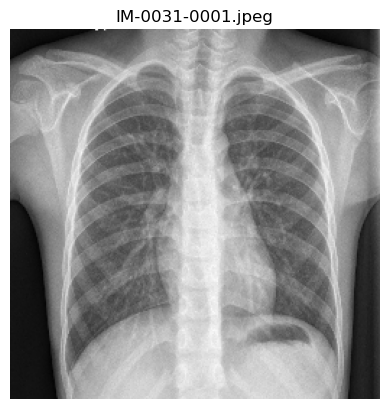

1/1 [==============================] - 0s 43ms/step
Predicted category is - D!


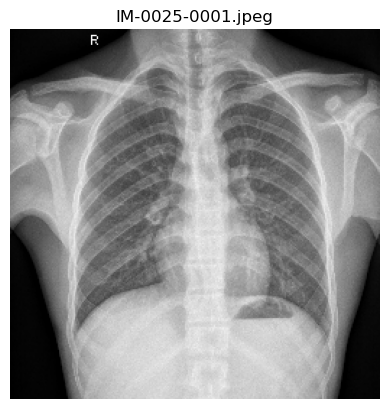

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


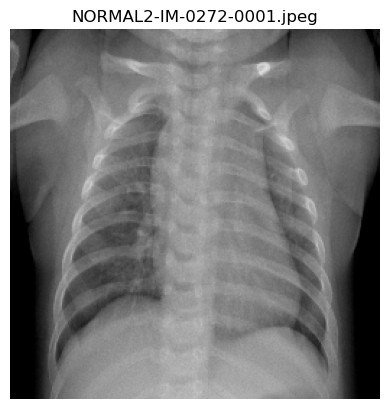

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


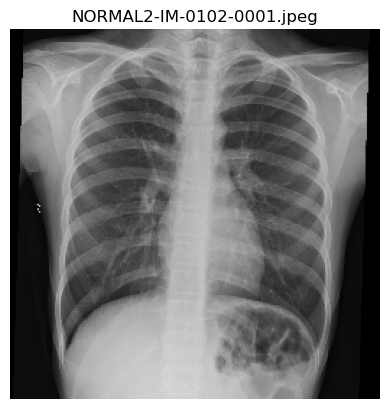

1/1 [==============================] - 0s 16ms/step
Predicted category is - D!


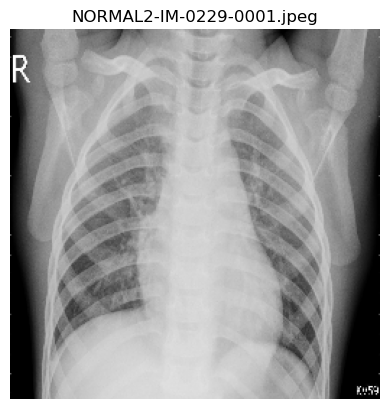

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


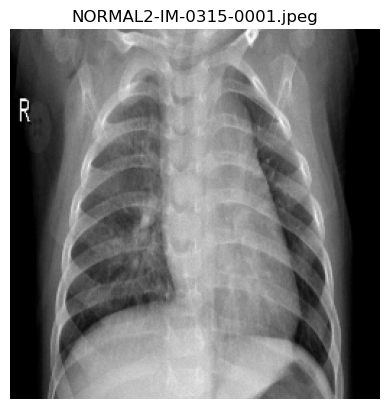

1/1 [==============================] - 0s 16ms/step
Predicted category is - D!


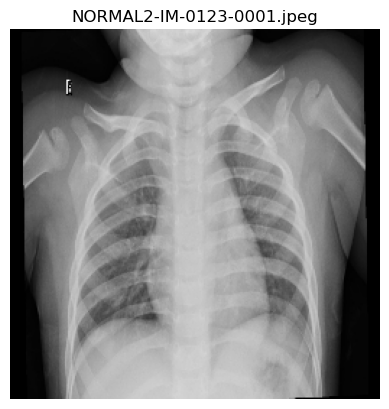

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


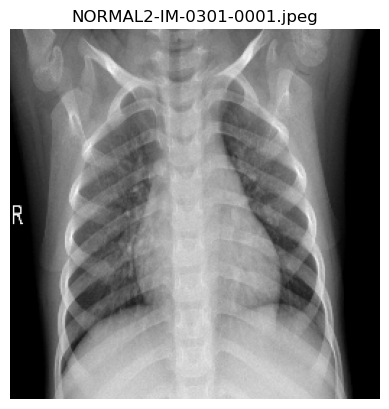

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


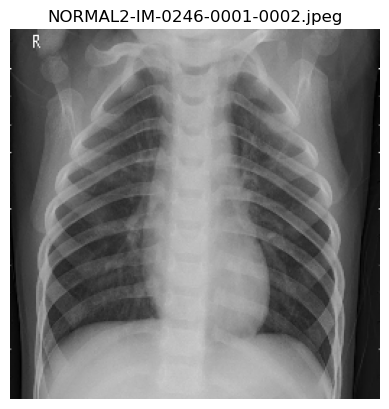

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


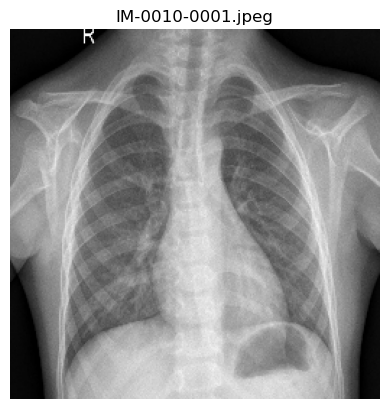

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


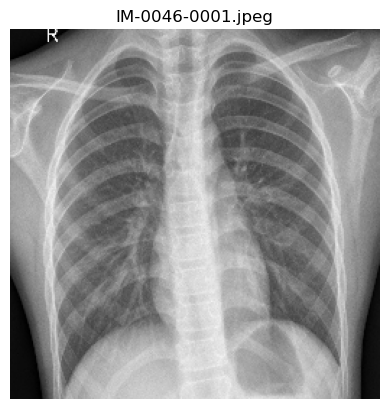

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


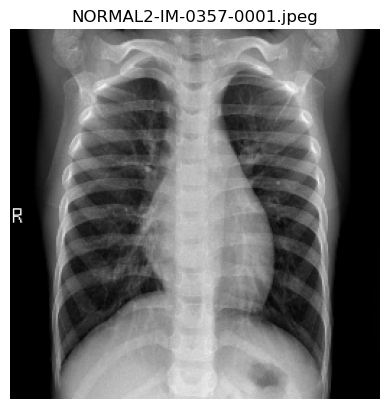

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


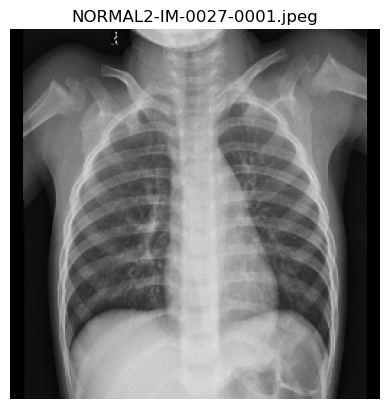

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


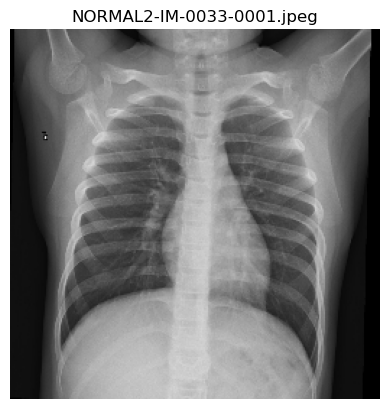

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


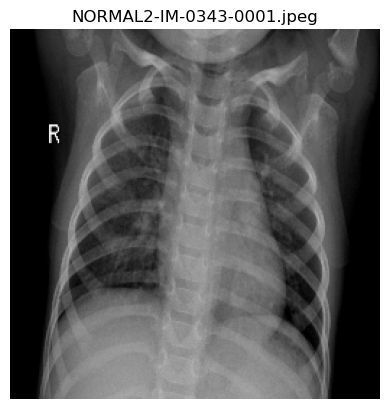

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


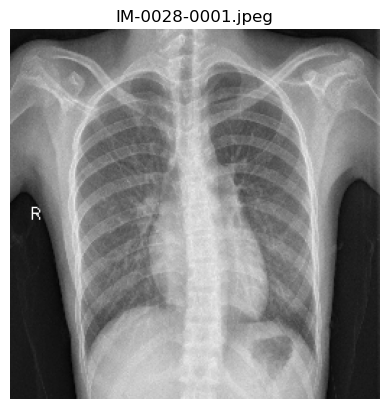

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


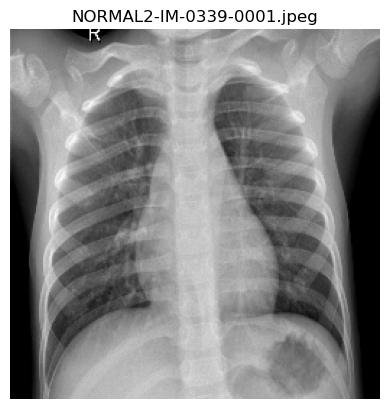

1/1 [==============================] - 0s 14ms/step
Predicted category is - A!


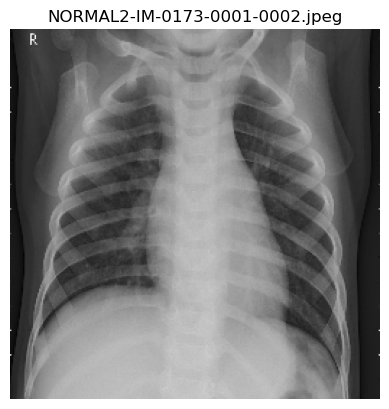

1/1 [==============================] - 0s 14ms/step
Predicted category is - D!


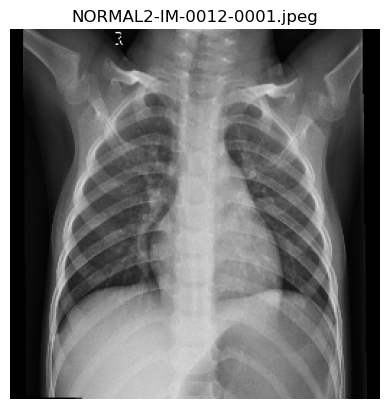

1/1 [==============================] - 0s 14ms/step
Predicted category is - A!


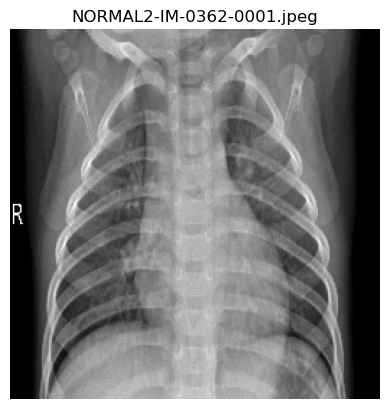

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


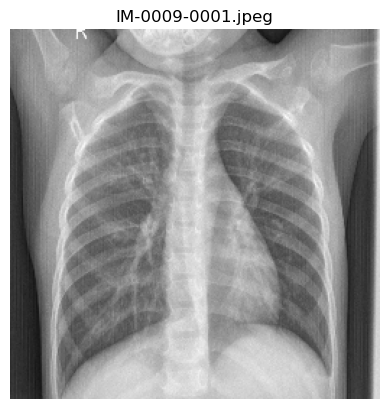

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


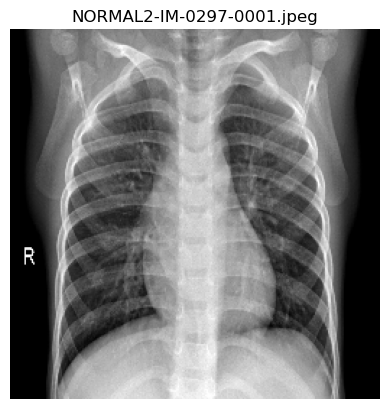

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


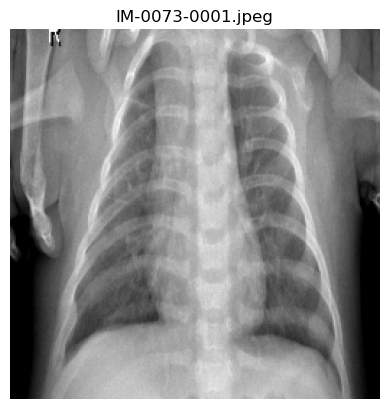

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


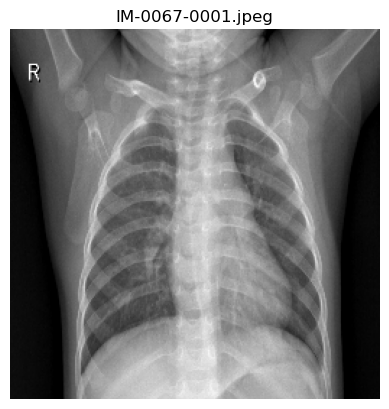

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


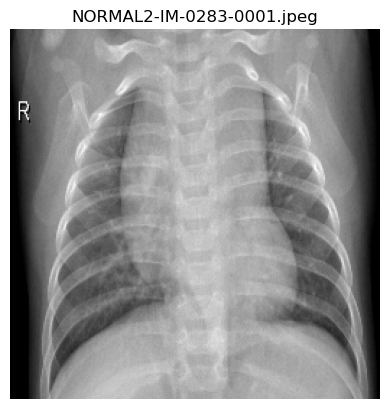

1/1 [==============================] - 0s 14ms/step
Predicted category is - D!


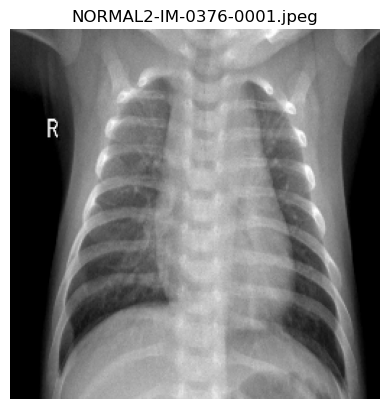

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


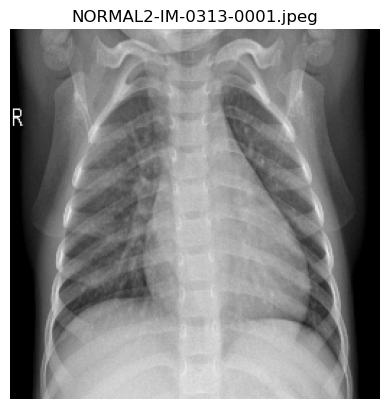

1/1 [==============================] - 0s 14ms/step
Predicted category is - D!


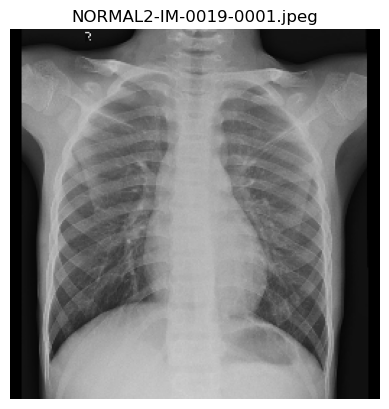

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


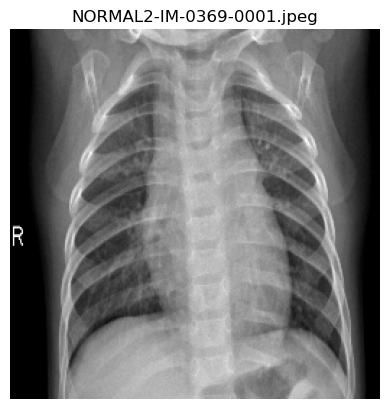

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


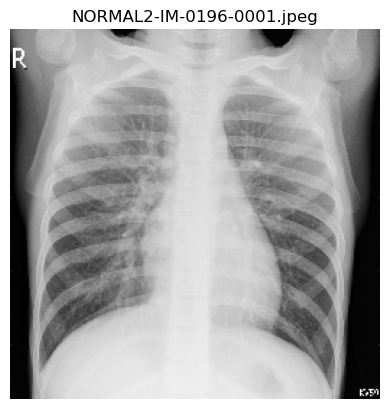

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


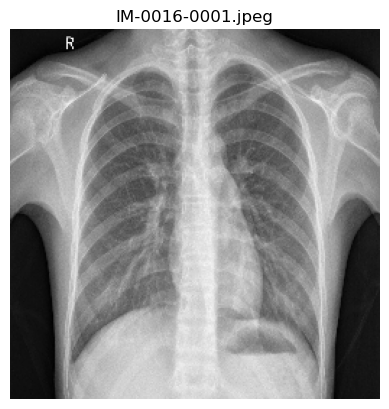

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


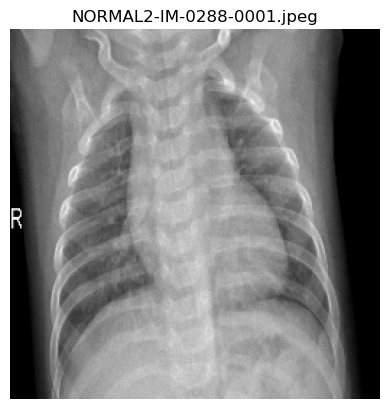

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


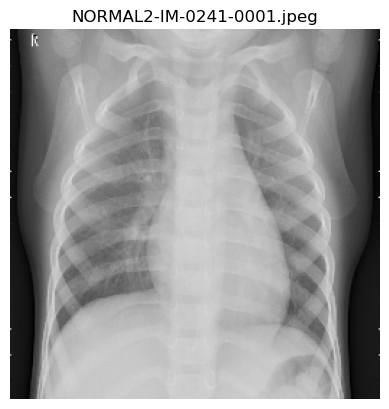

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


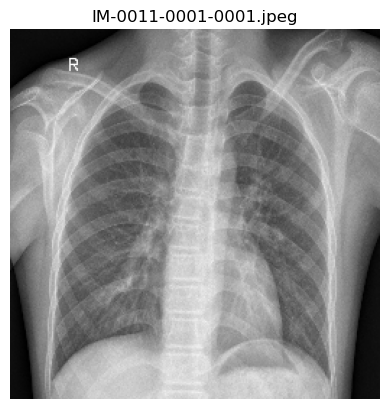

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


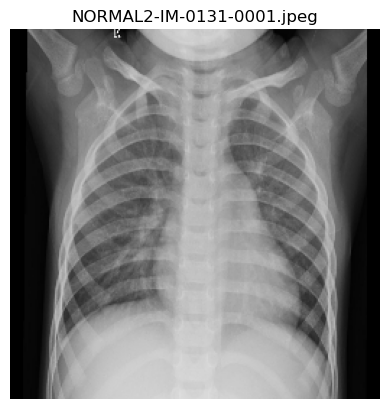

1/1 [==============================] - 0s 16ms/step
Predicted category is - D!


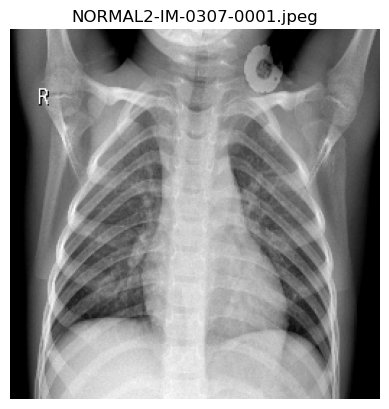

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


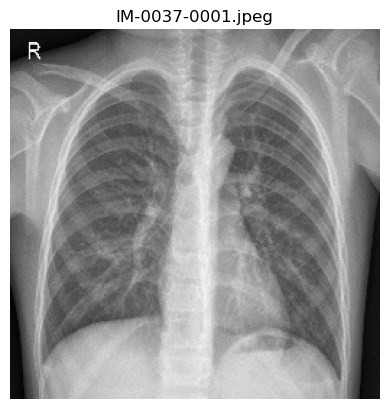

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


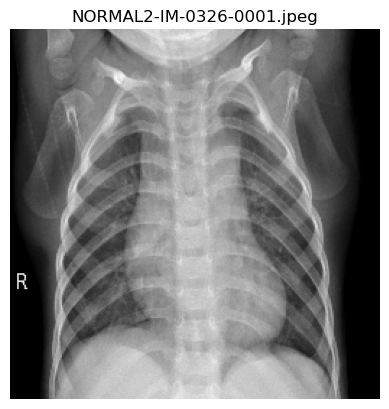

1/1 [==============================] - 0s 14ms/step
Predicted category is - D!


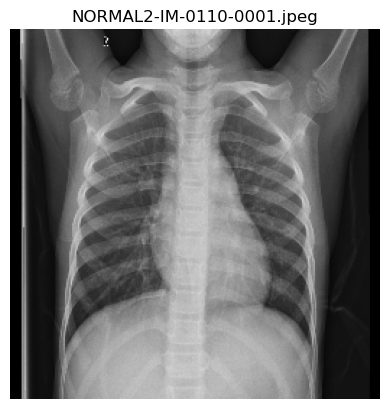

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


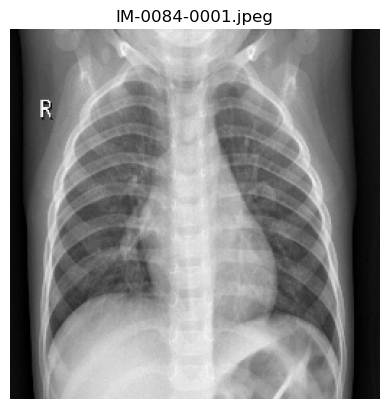

1/1 [==============================] - 0s 14ms/step
Predicted category is - A!


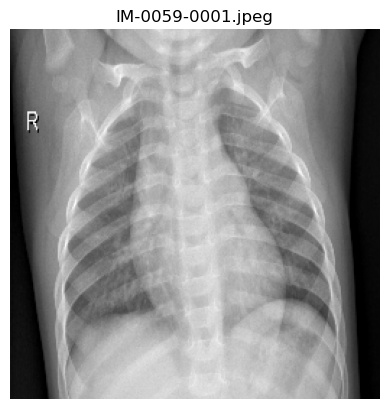

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


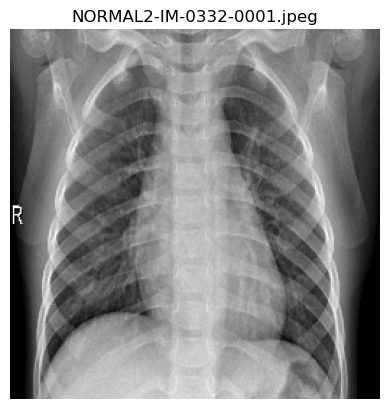

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


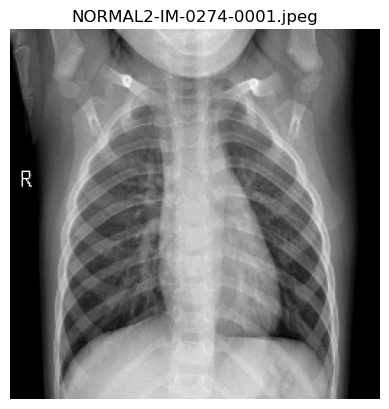

1/1 [==============================] - 0s 14ms/step
Predicted category is - A!


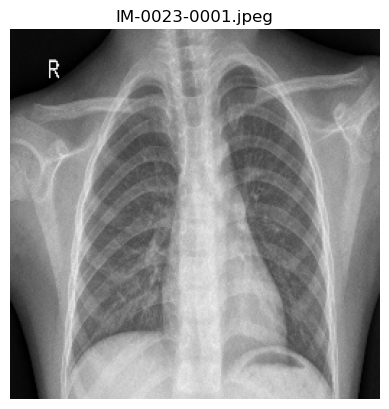

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


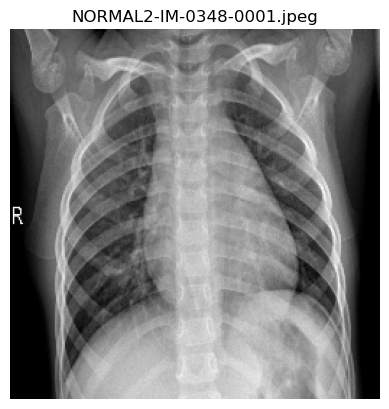

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


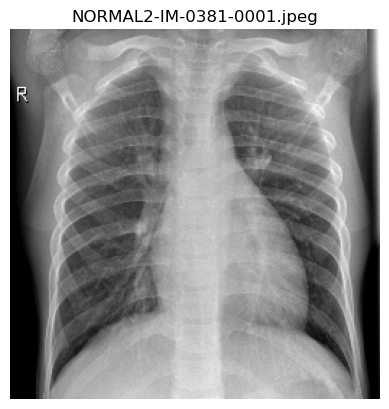

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


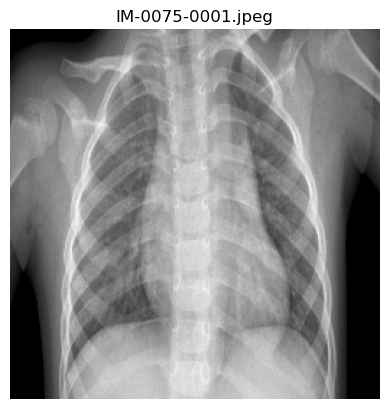

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


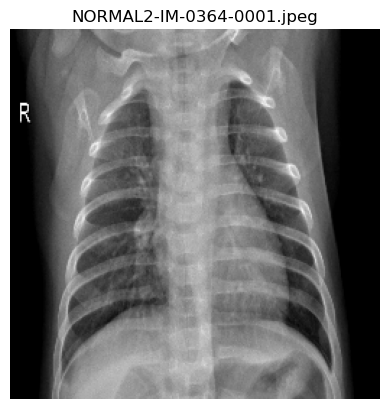

1/1 [==============================] - 0s 16ms/step
Predicted category is - D!


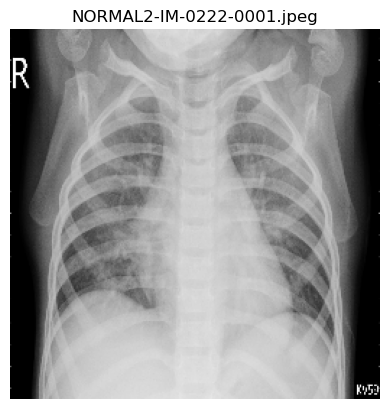

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


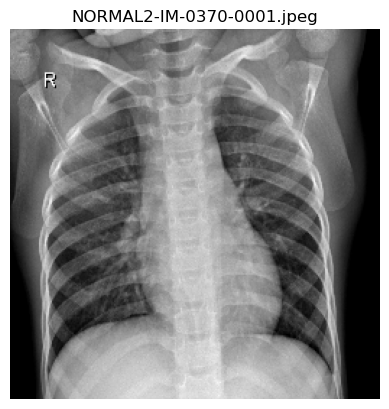

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


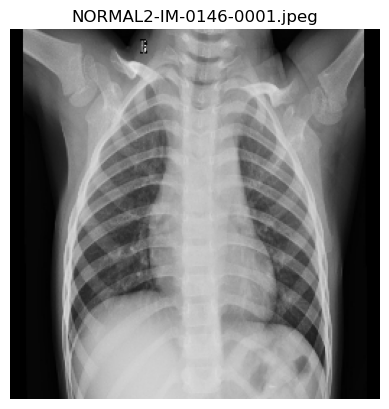

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


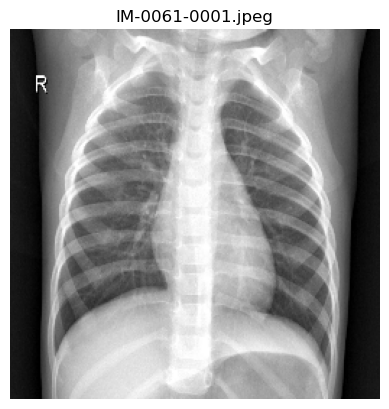

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


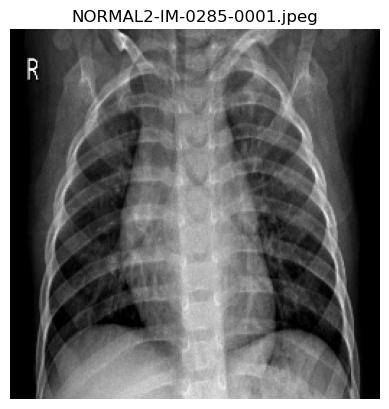

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


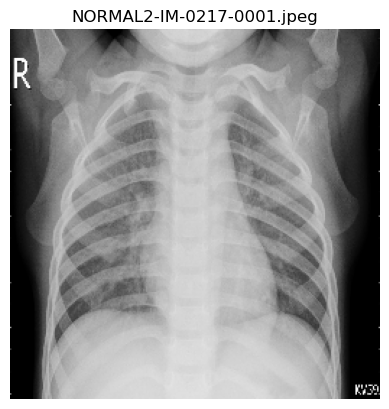

1/1 [==============================] - 0s 14ms/step
Predicted category is - D!


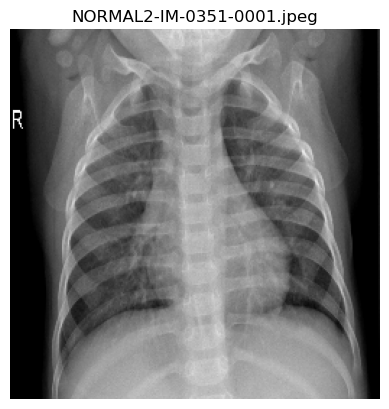

1/1 [==============================] - 0s 14ms/step
Predicted category is - A!


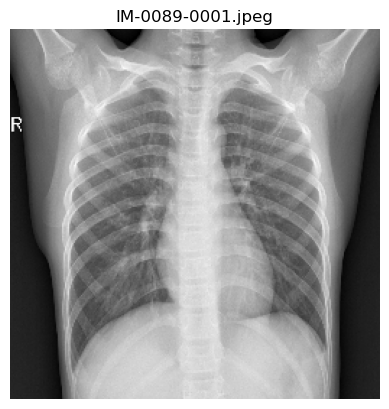

1/1 [==============================] - 0s 16ms/step
Predicted category is - A!


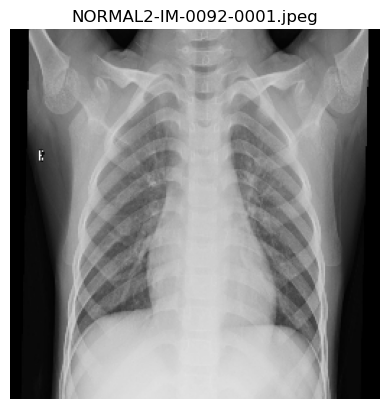

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


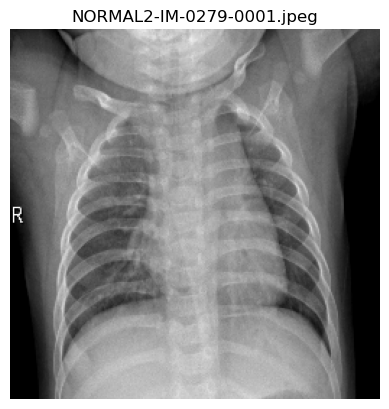

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


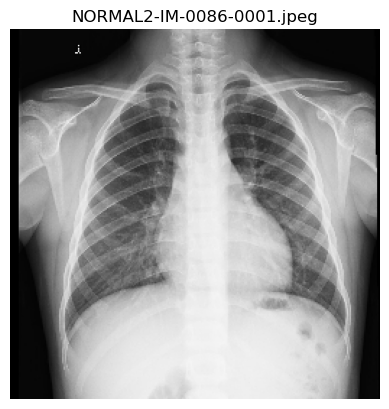

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


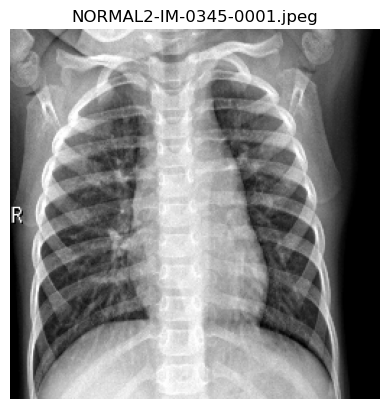

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


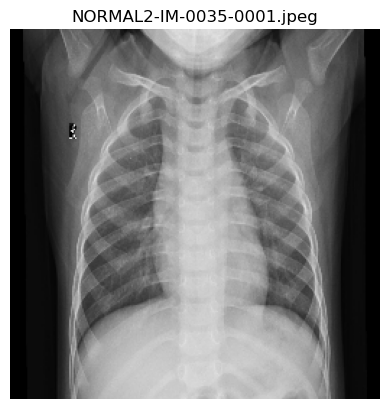

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


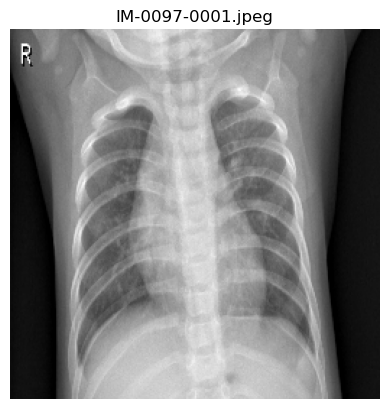

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


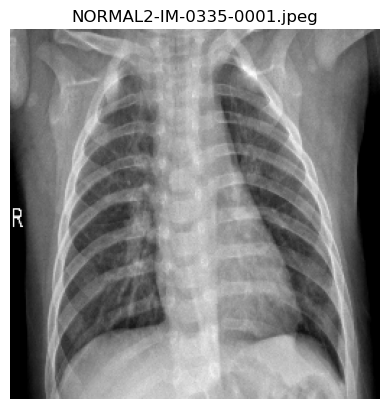

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


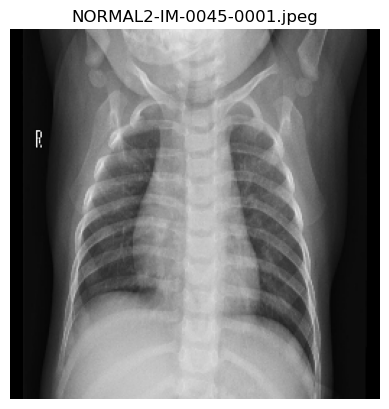

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


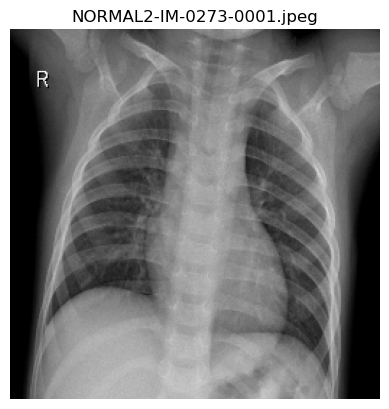

1/1 [==============================] - 0s 16ms/step
Predicted category is - A!


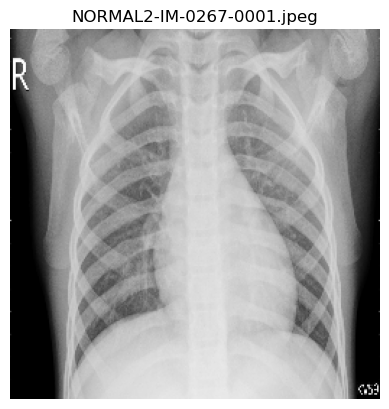

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


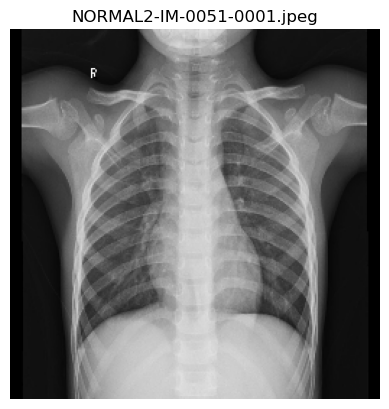

1/1 [==============================] - 0s 14ms/step
Predicted category is - A!


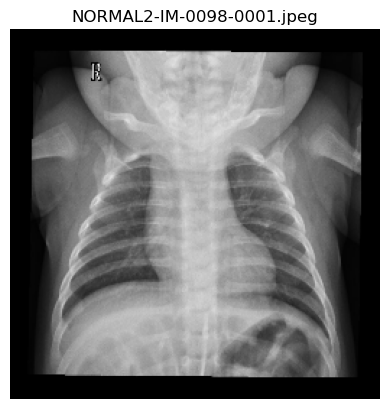

1/1 [==============================] - 0s 14ms/step
Predicted category is - A!


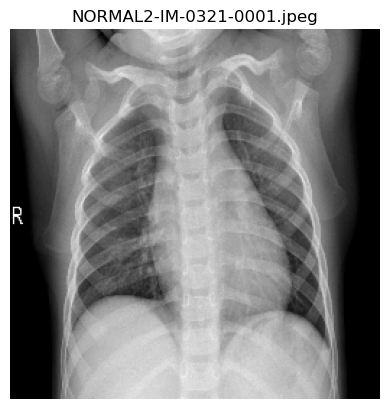

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


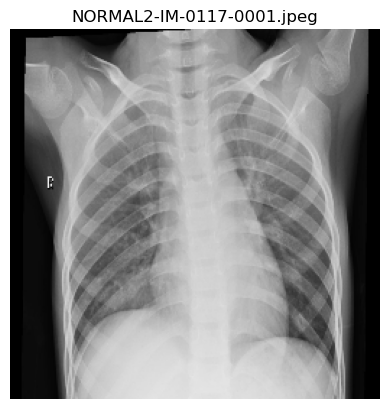

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


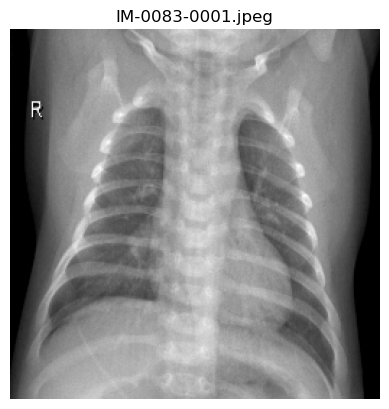

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


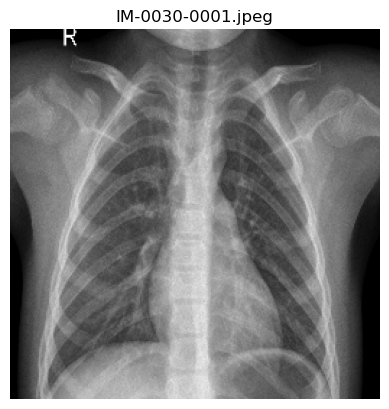

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


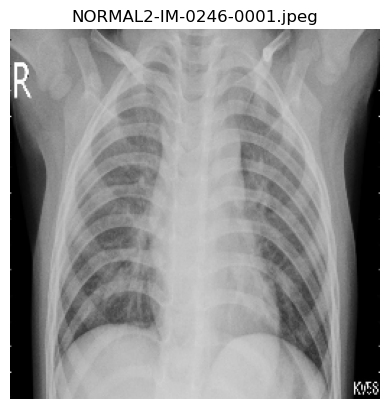

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


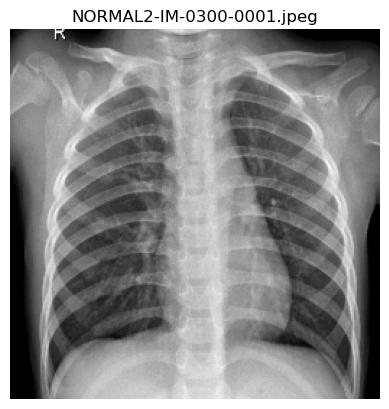

1/1 [==============================] - 0s 14ms/step
Predicted category is - D!


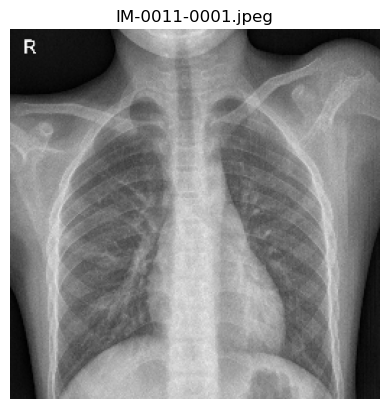

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


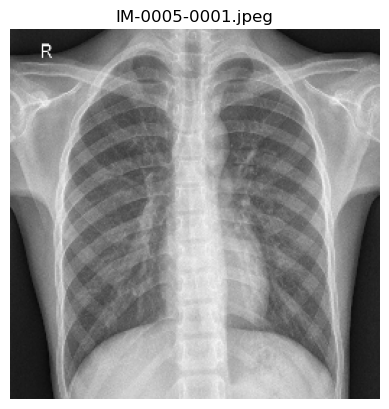

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


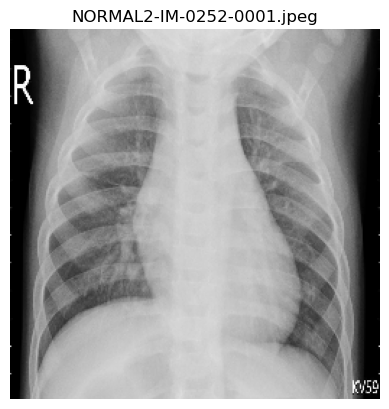

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


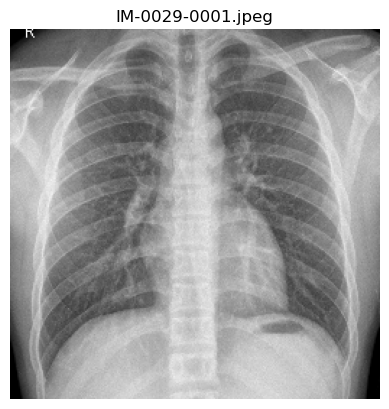

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


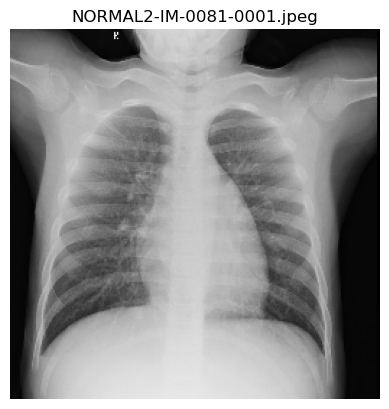

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


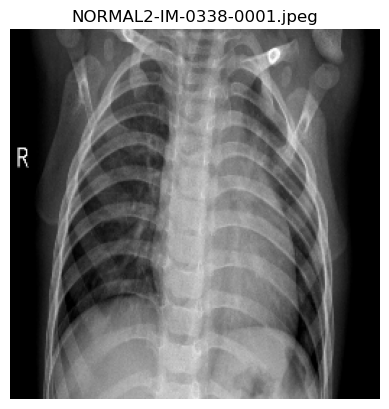

1/1 [==============================] - 0s 16ms/step
Predicted category is - D!


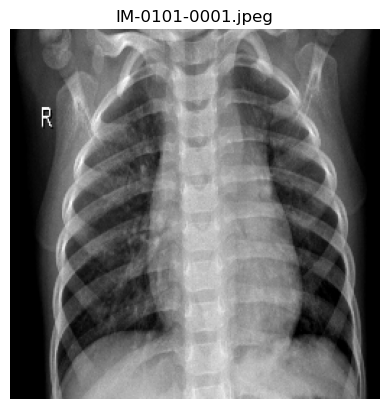

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


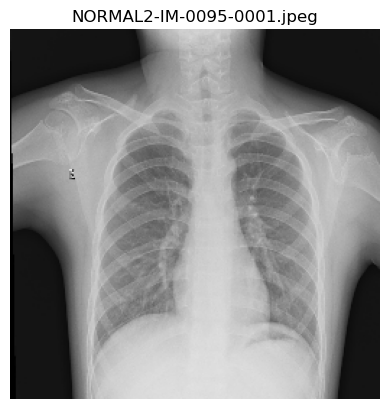

1/1 [==============================] - 0s 14ms/step
Predicted category is - A!


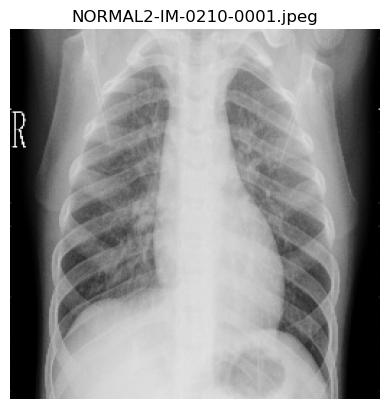

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


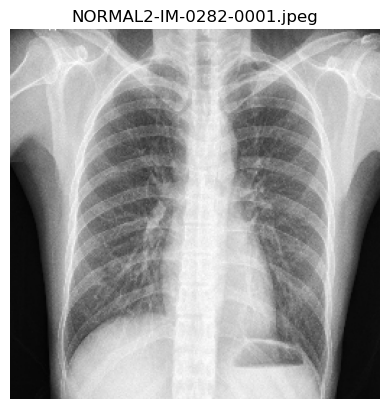

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


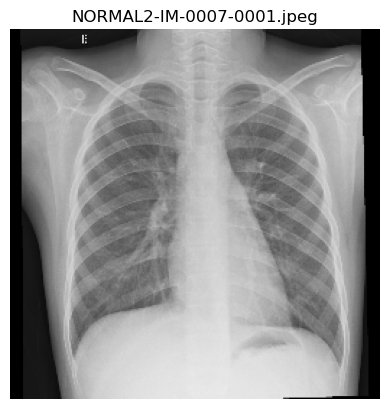

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


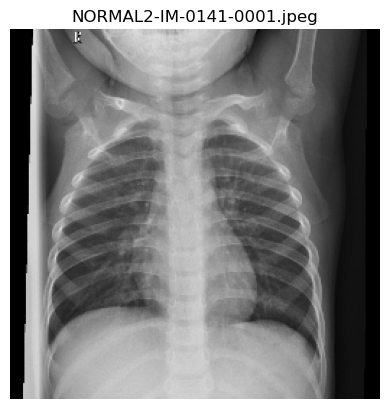

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


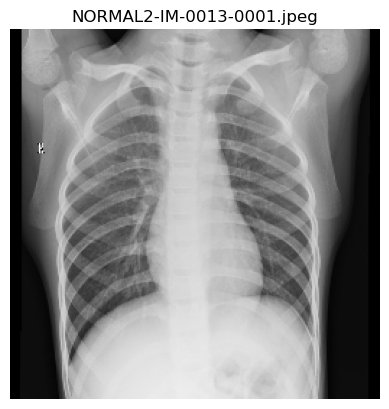

1/1 [==============================] - 0s 18ms/step
Predicted category is - A!


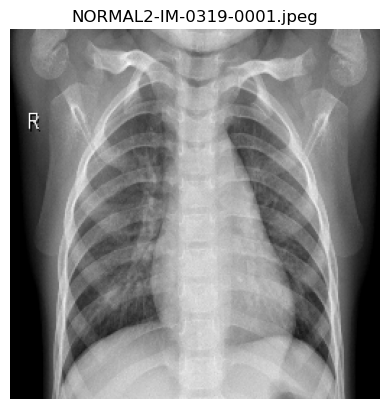

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


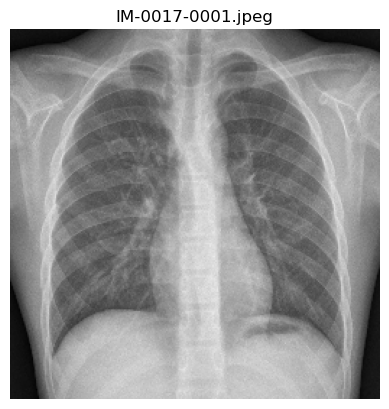

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


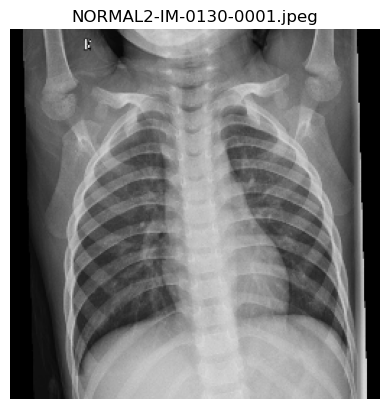

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


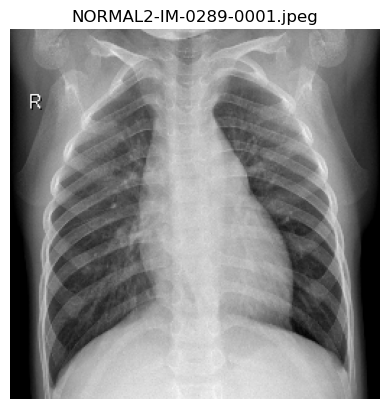

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


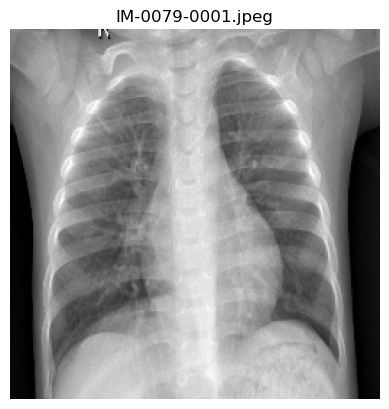

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


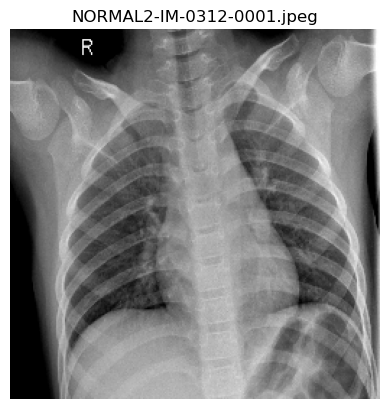

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


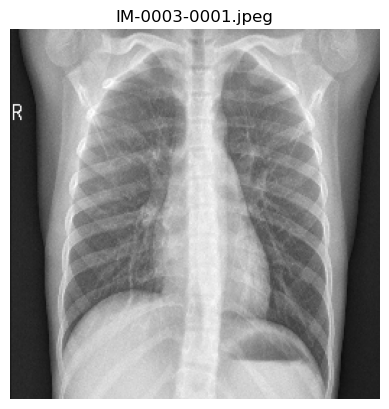

1/1 [==============================] - 0s 14ms/step
Predicted category is - D!


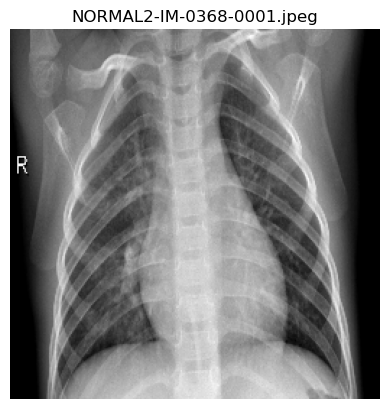

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


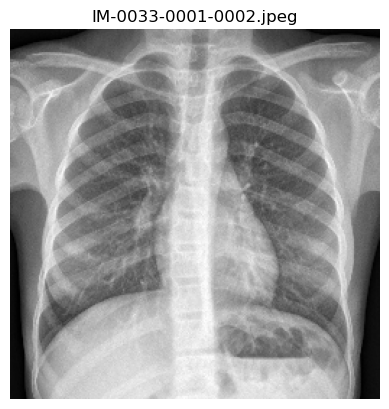

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


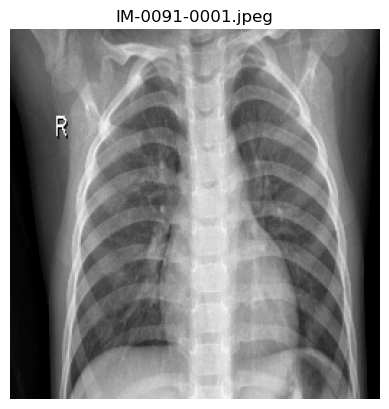

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


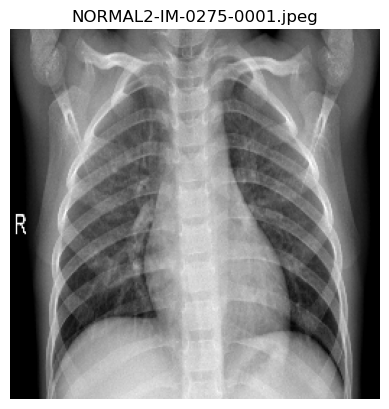

1/1 [==============================] - 0s 14ms/step
Predicted category is - A!


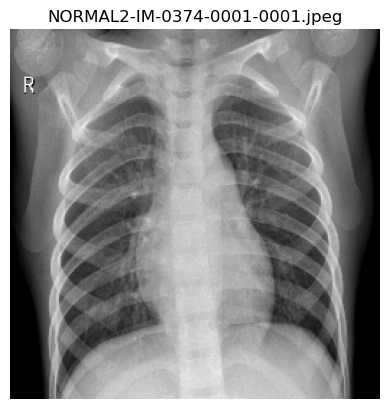

1/1 [==============================] - 0s 16ms/step
Predicted category is - D!


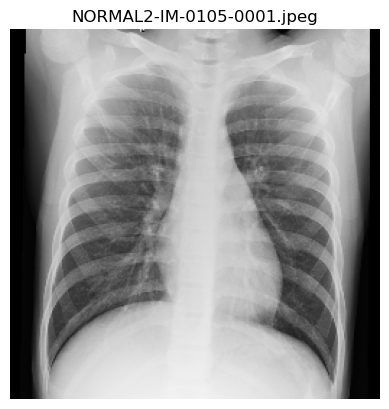

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


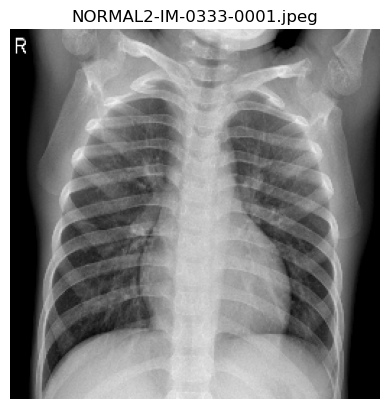

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


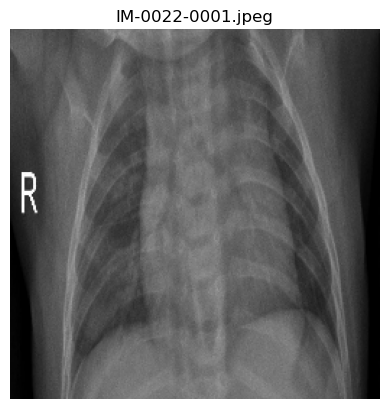

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


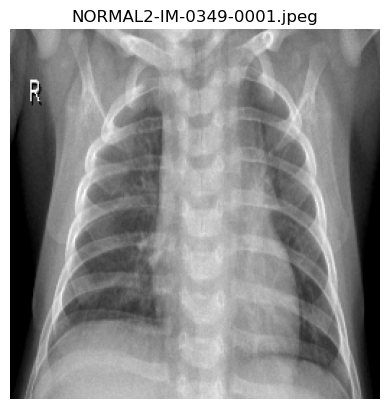

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


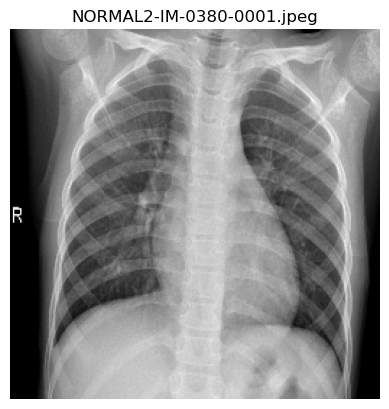

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


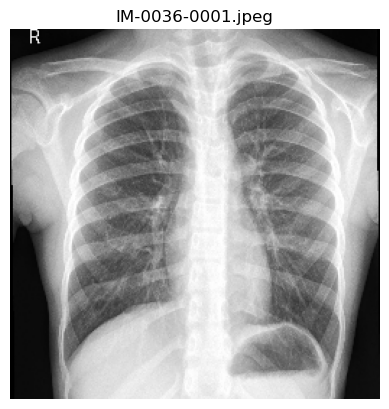

1/1 [==============================] - 0s 16ms/step
Predicted category is - D!


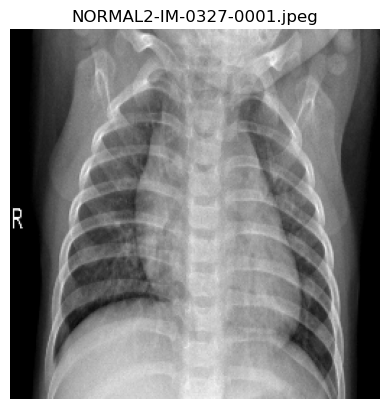

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


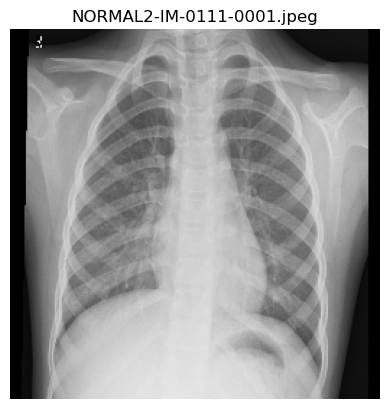

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


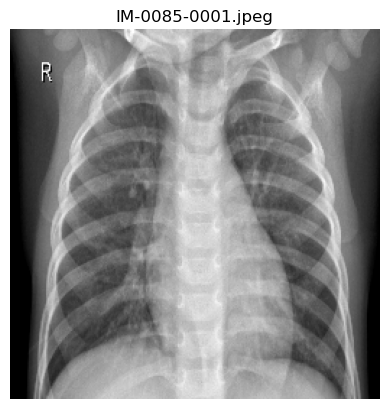

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


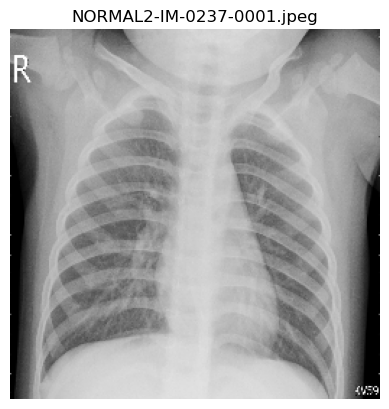

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


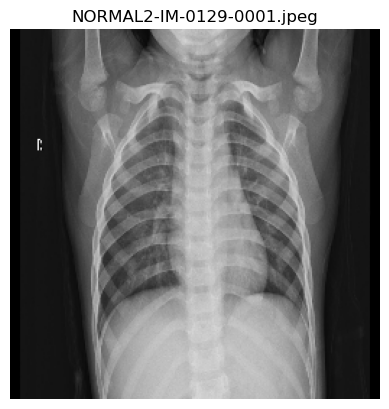

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


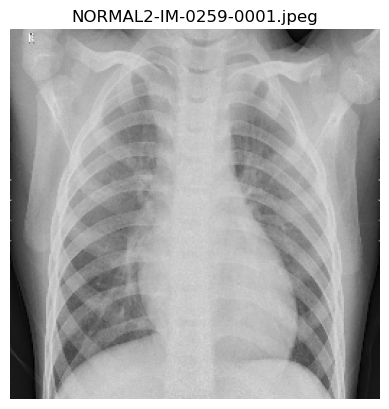

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


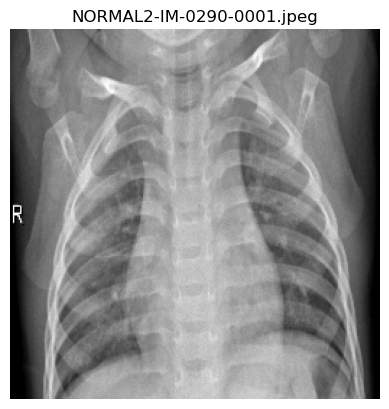

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


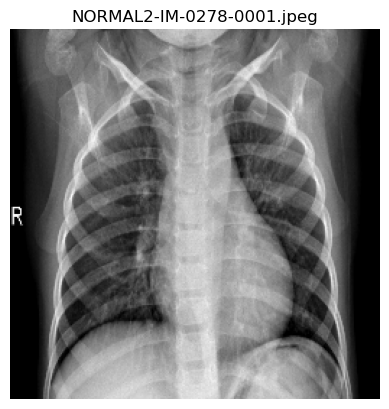

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


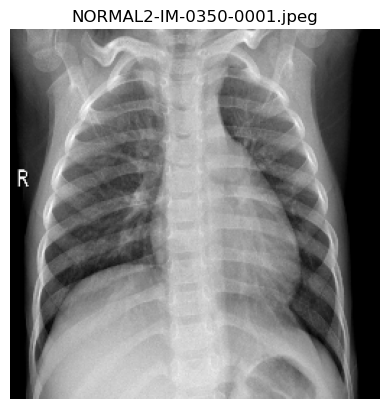

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


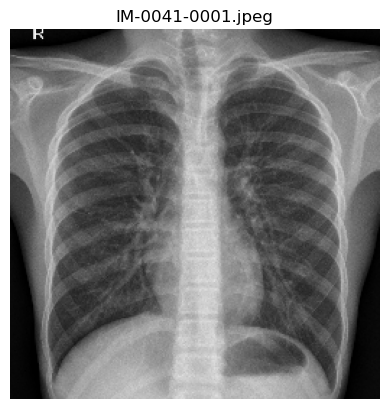

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


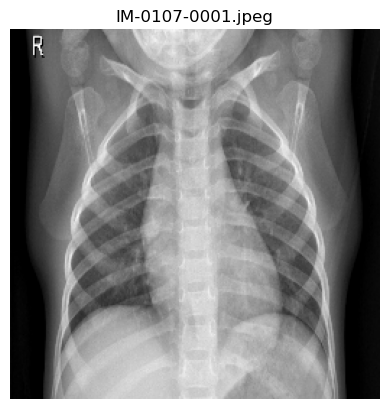

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


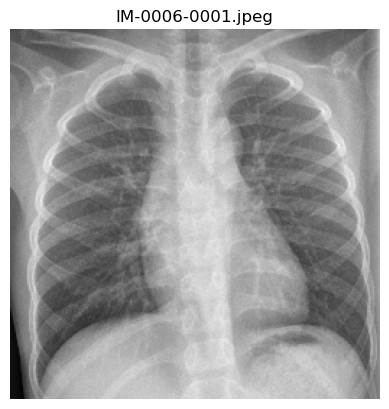

1/1 [==============================] - 0s 16ms/step
Predicted category is - D!


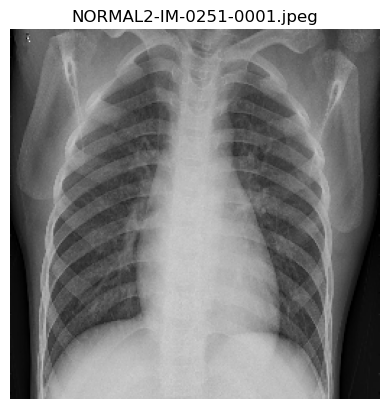

1/1 [==============================] - 0s 16ms/step
Predicted category is - D!


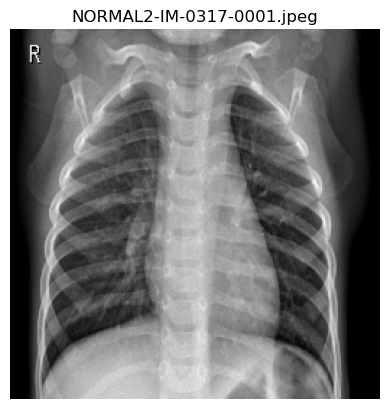

1/1 [==============================] - 0s 17ms/step
Predicted category is - D!


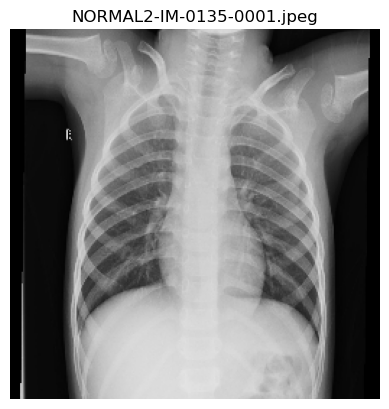

1/1 [==============================] - 0s 20ms/step
Predicted category is - D!


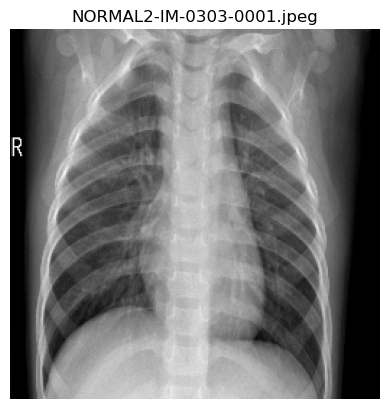

1/1 [==============================] - 0s 23ms/step
Predicted category is - D!


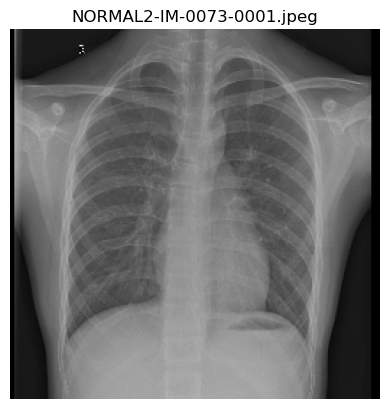

1/1 [==============================] - 0s 21ms/step
Predicted category is - D!


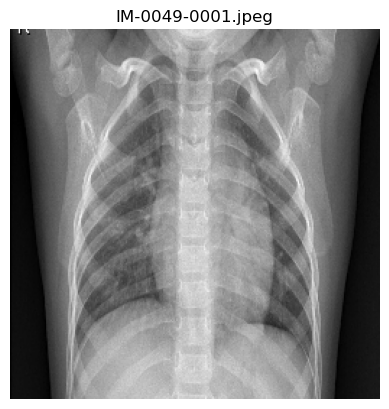

1/1 [==============================] - 0s 23ms/step
Predicted category is - D!


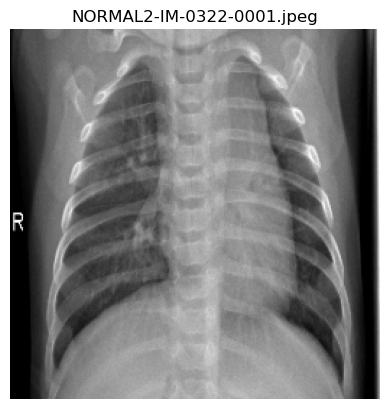

1/1 [==============================] - 0s 19ms/step
Predicted category is - D!


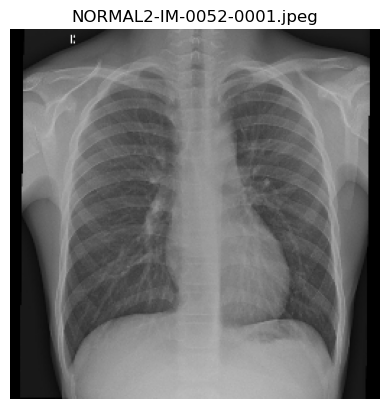

1/1 [==============================] - 0s 18ms/step
Predicted category is - D!


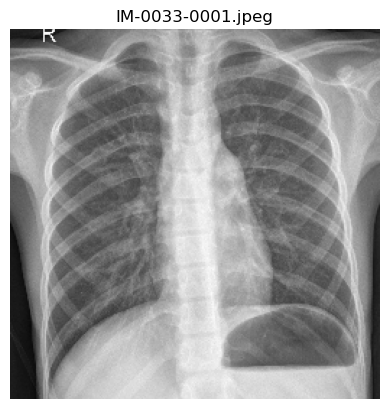

1/1 [==============================] - 0s 17ms/step
Predicted category is - D!


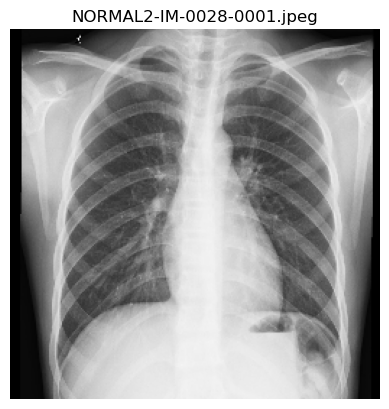

1/1 [==============================] - 0s 16ms/step
Predicted category is - A!


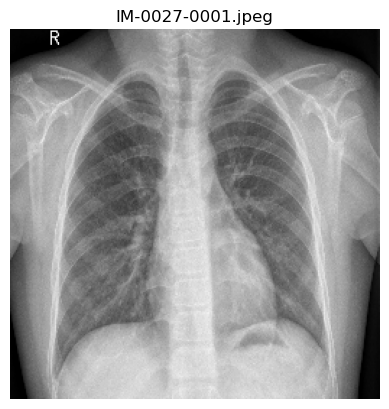

1/1 [==============================] - 0s 21ms/step
Predicted category is - A!


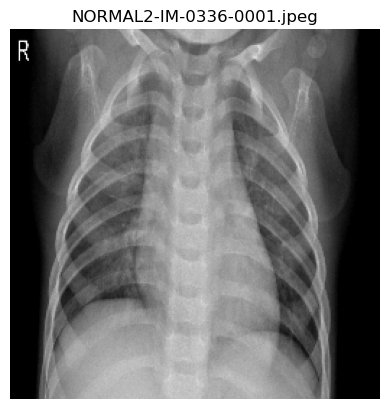

1/1 [==============================] - 0s 20ms/step
Predicted category is - D!


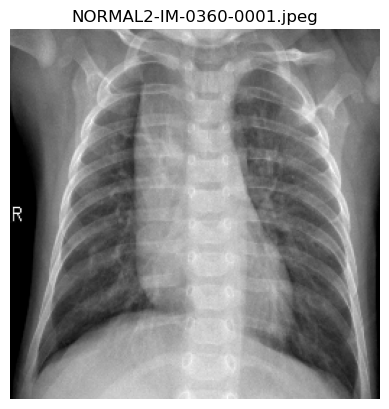

1/1 [==============================] - 0s 21ms/step
Predicted category is - D!


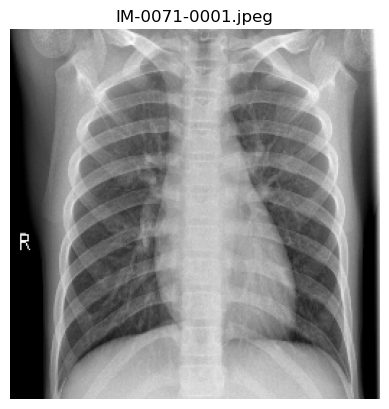

1/1 [==============================] - 0s 16ms/step
Predicted category is - D!


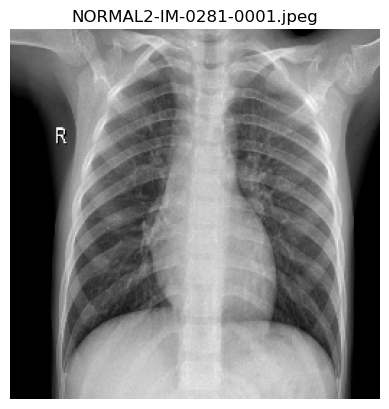

1/1 [==============================] - 0s 17ms/step
Predicted category is - D!


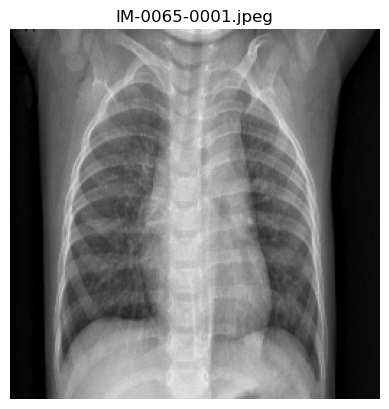

1/1 [==============================] - 0s 16ms/step
Predicted category is - D!


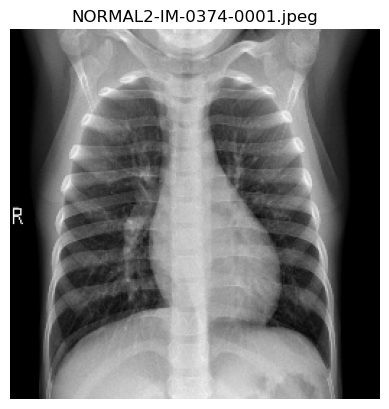

1/1 [==============================] - 0s 17ms/step
Predicted category is - A!


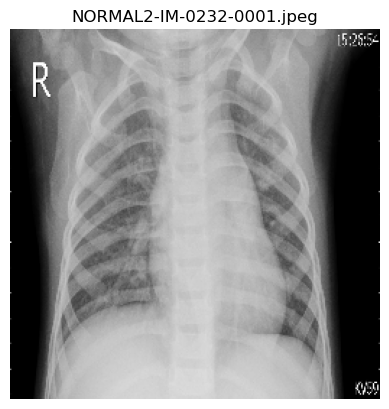

1/1 [==============================] - 0s 17ms/step
Predicted category is - D!


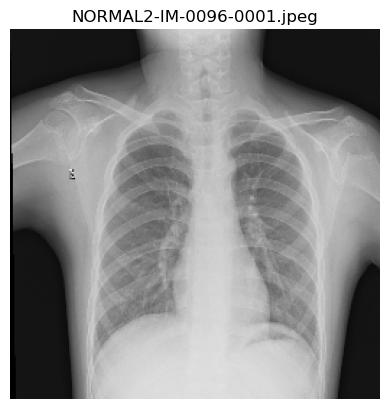

1/1 [==============================] - 0s 17ms/step
Predicted category is - A!


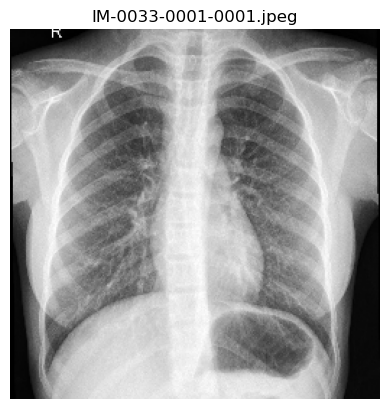

1/1 [==============================] - 0s 23ms/step
Predicted category is - D!


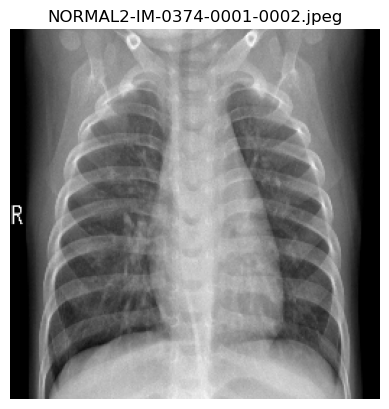

1/1 [==============================] - 0s 20ms/step
Predicted category is - D!


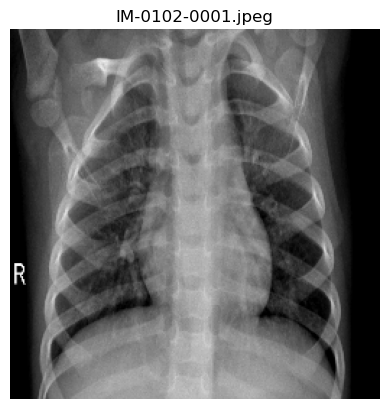

1/1 [==============================] - 0s 19ms/step
Predicted category is - D!


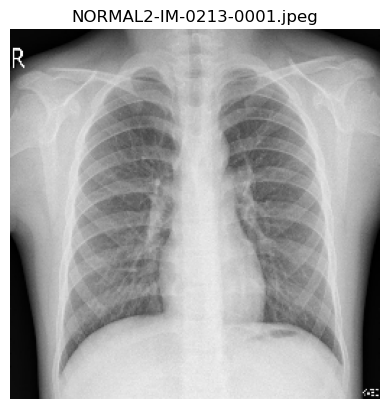

1/1 [==============================] - 0s 17ms/step
Predicted category is - D!


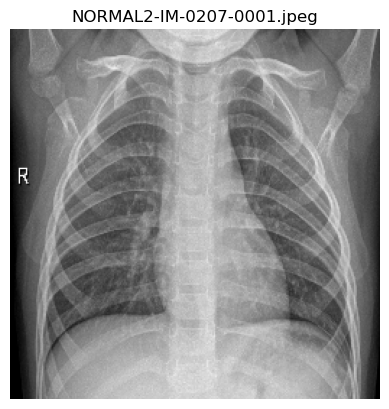

1/1 [==============================] - 0s 17ms/step
Predicted category is - A!


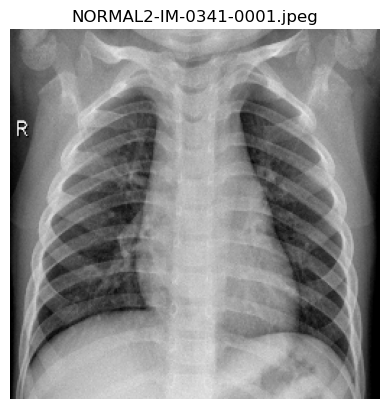

1/1 [==============================] - 0s 17ms/step
Predicted category is - A!


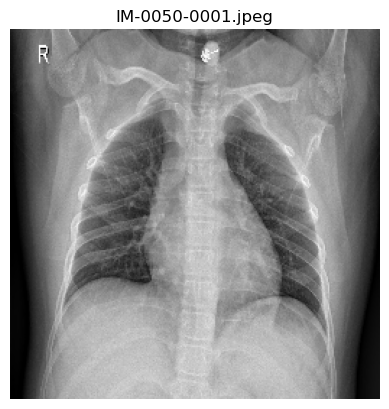

1/1 [==============================] - 0s 16ms/step
Predicted category is - A!


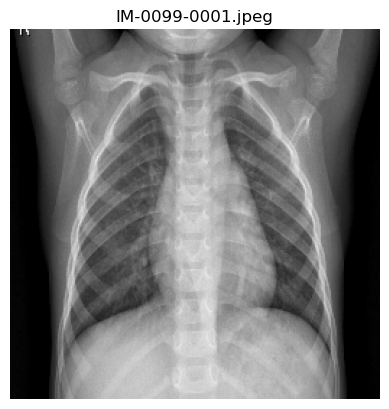

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


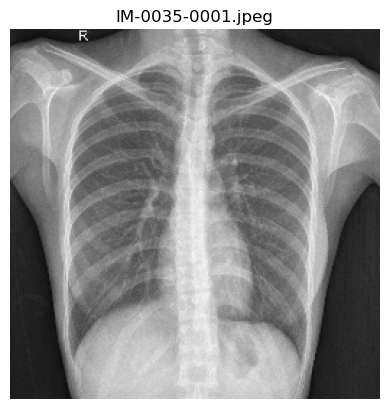

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


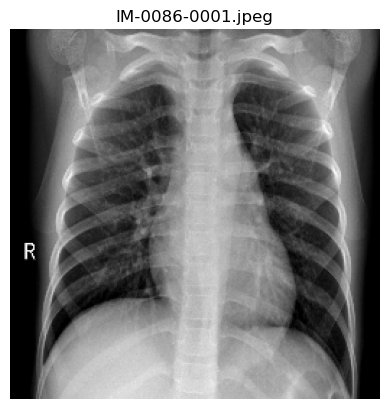

1/1 [==============================] - 0s 16ms/step
Predicted category is - A!


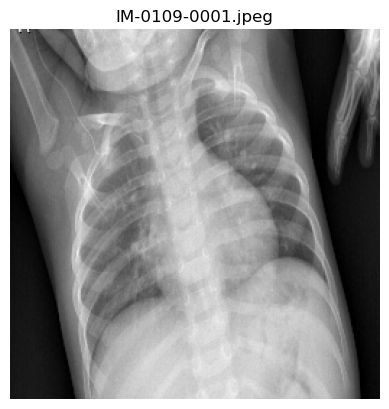

1/1 [==============================] - 0s 16ms/step
Predicted category is - D!


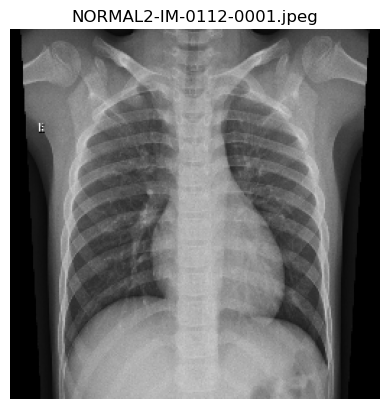

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


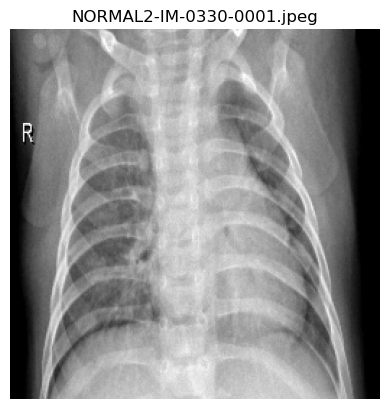

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


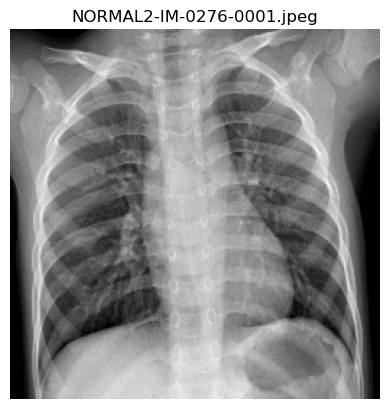

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


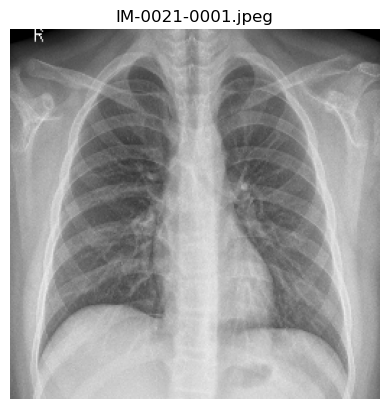

1/1 [==============================] - 0s 16ms/step
Predicted category is - D!


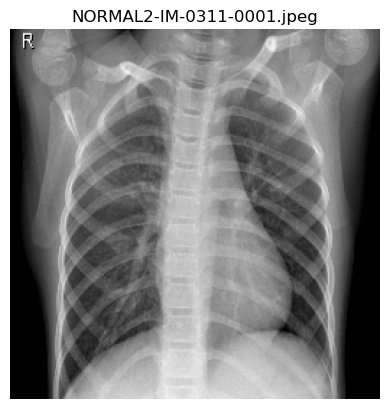

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


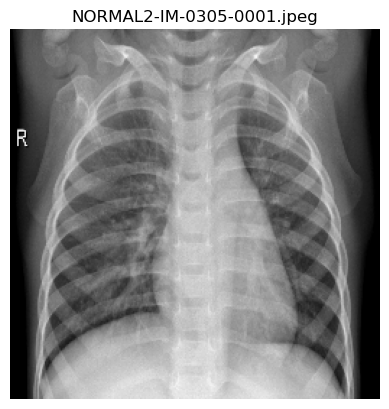

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


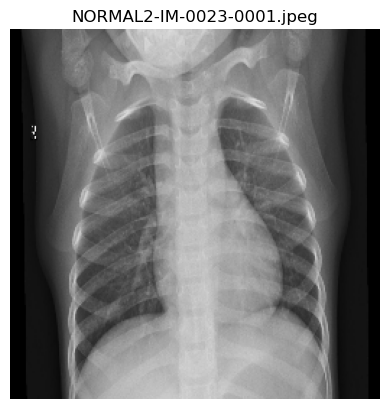

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


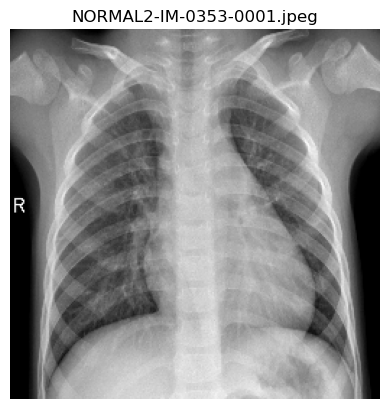

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


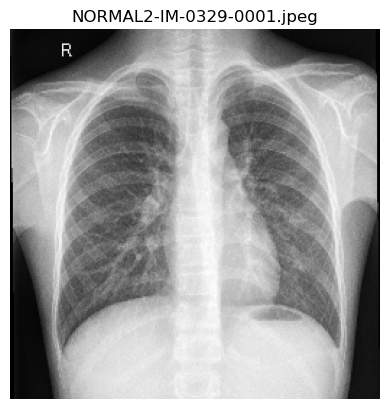

1/1 [==============================] - 0s 14ms/step
Predicted category is - A!


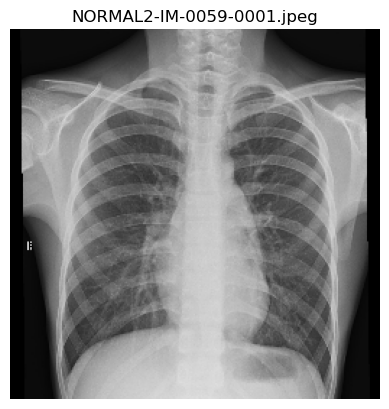

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


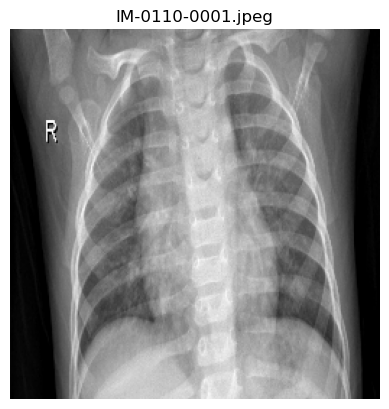

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


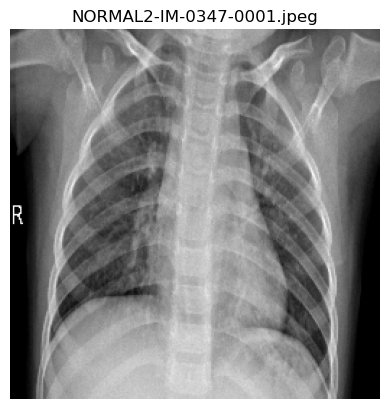

1/1 [==============================] - 0s 14ms/step
Predicted category is - D!


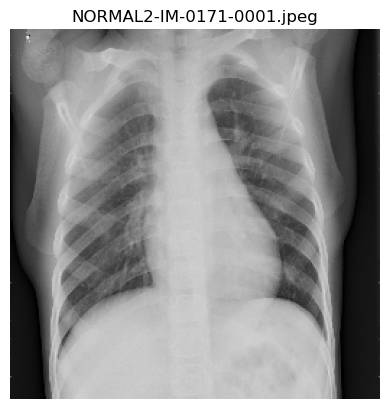

1/1 [==============================] - 0s 14ms/step
Predicted category is - A!


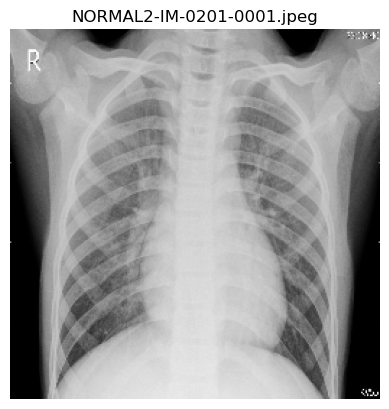

1/1 [==============================] - 0s 14ms/step
Predicted category is - D!


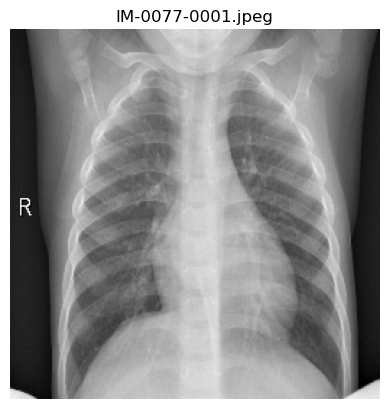

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


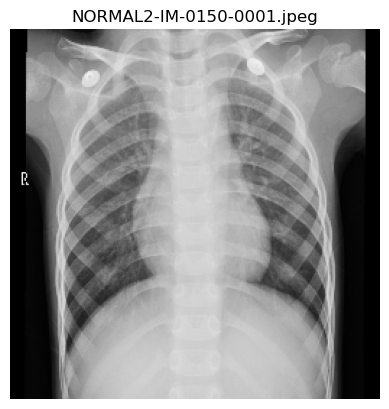

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


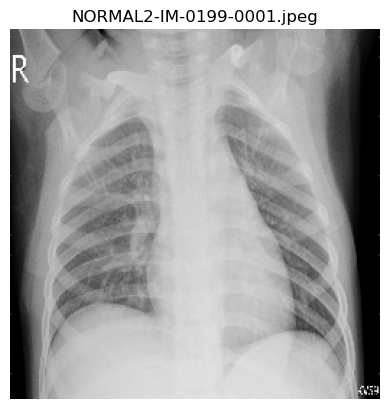

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


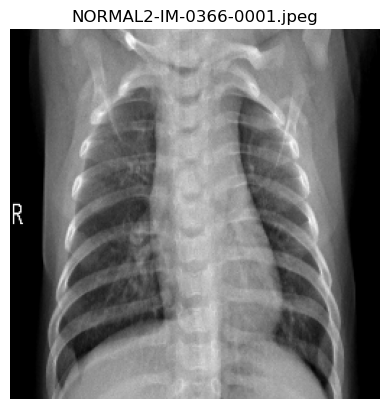

1/1 [==============================] - 0s 17ms/step
Predicted category is - D!


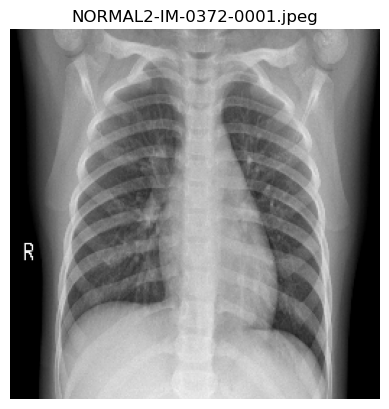

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


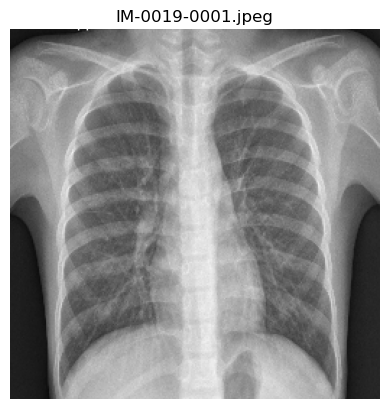

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


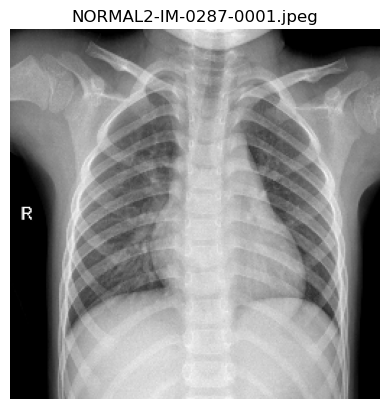

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


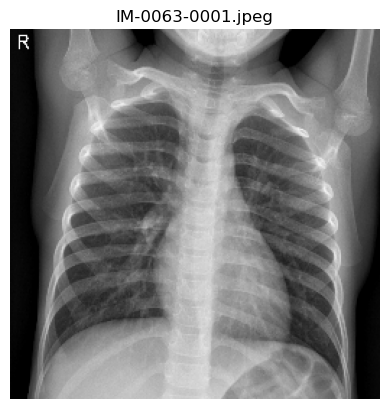

1/1 [==============================] - 0s 16ms/step
Predicted category is - D!


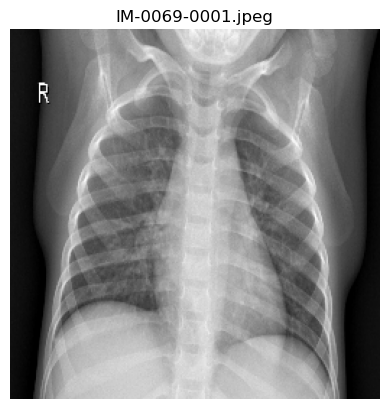

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


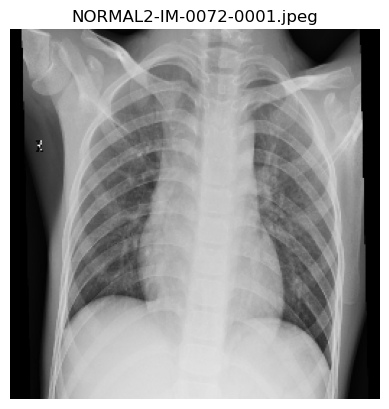

1/1 [==============================] - 0s 16ms/step
Predicted category is - D!


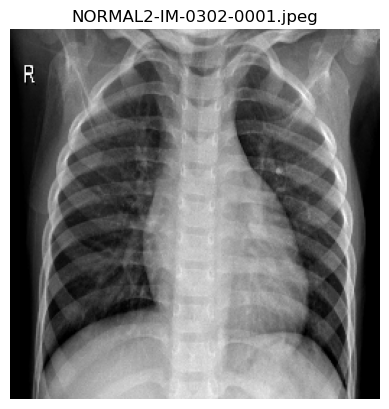

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


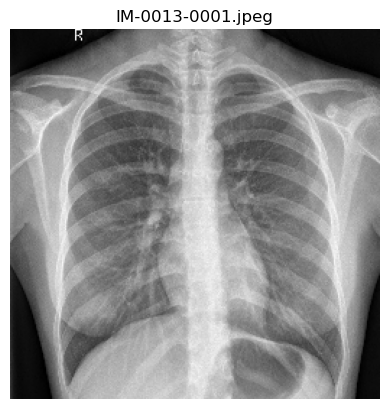

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


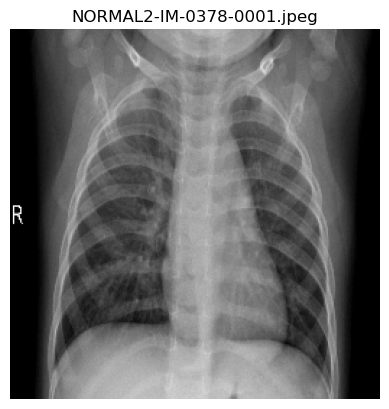

1/1 [==============================] - 0s 16ms/step
Predicted category is - D!


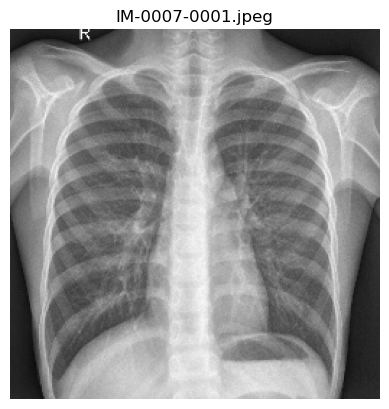

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


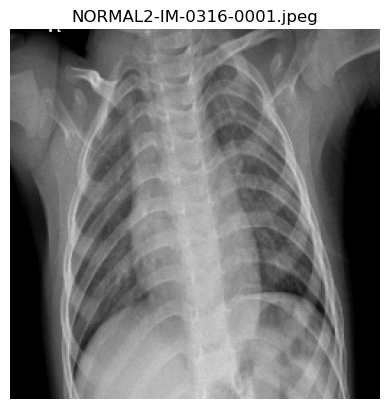

1/1 [==============================] - 0s 16ms/step
Predicted category is - D!


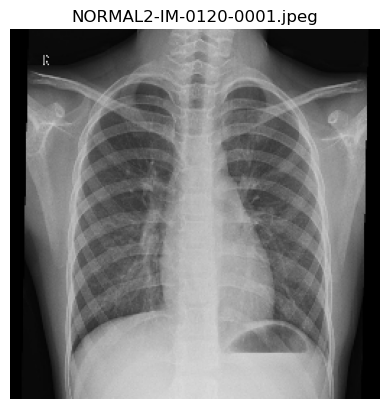

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


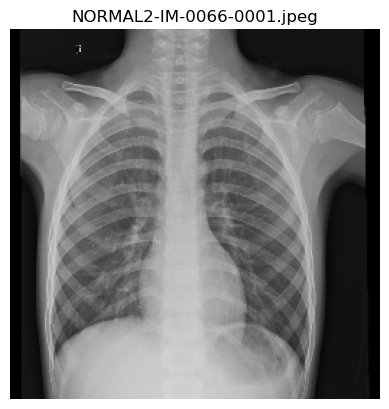

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


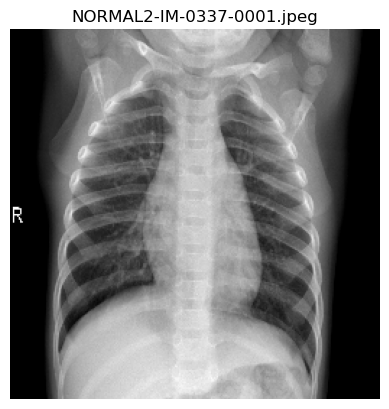

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


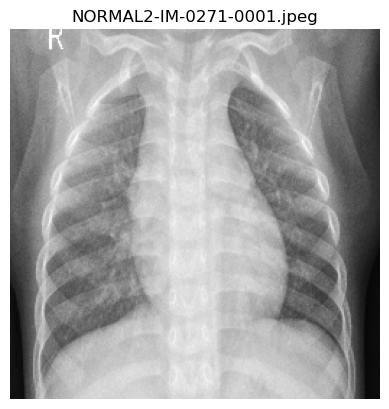

1/1 [==============================] - 0s 14ms/step
Predicted category is - D!


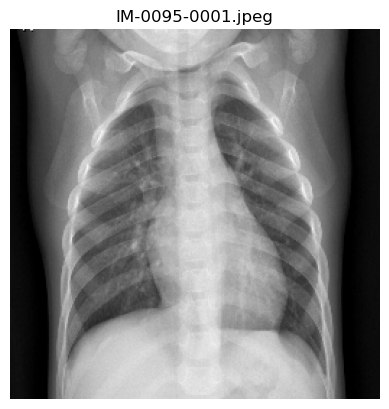

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


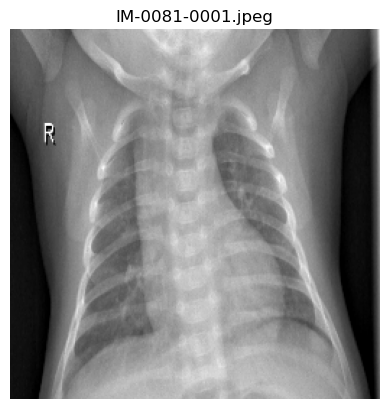

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


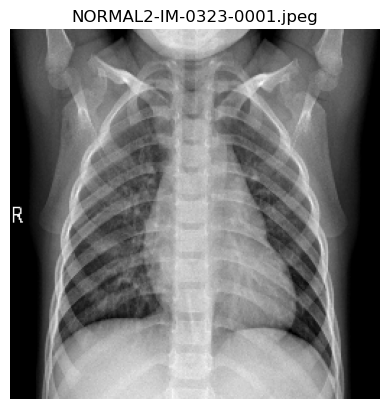

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


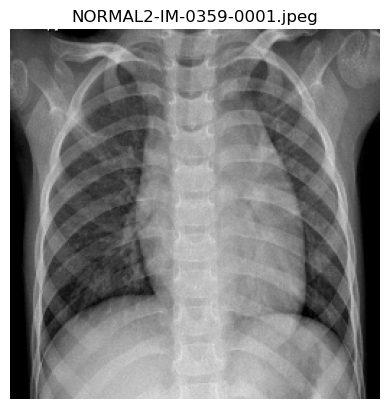

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


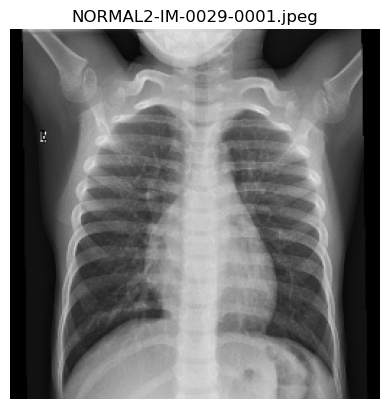

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


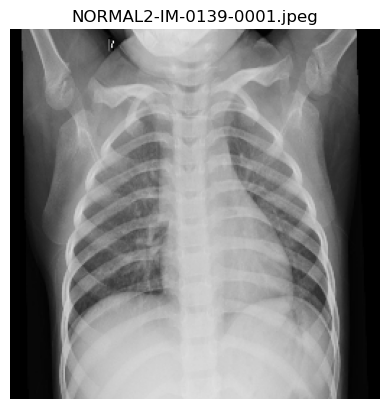

1/1 [==============================] - 0s 14ms/step
Predicted category is - A!


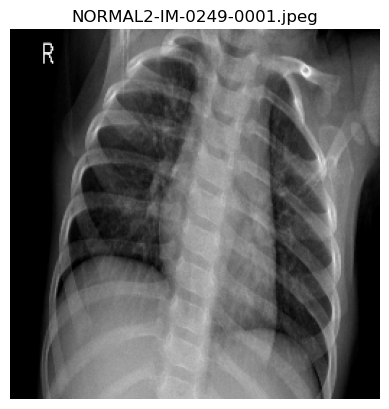

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


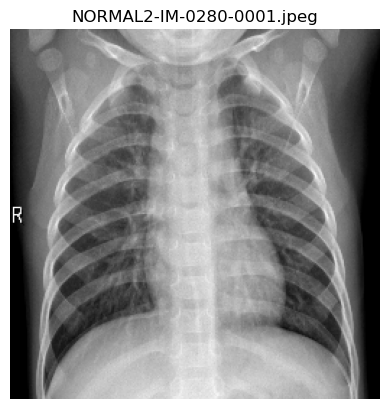

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


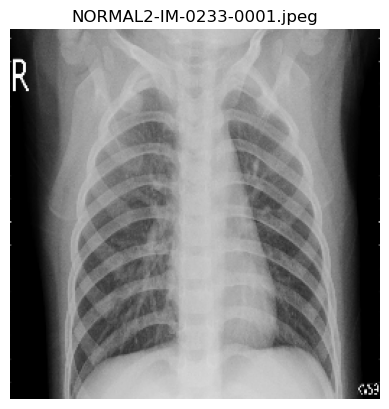

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


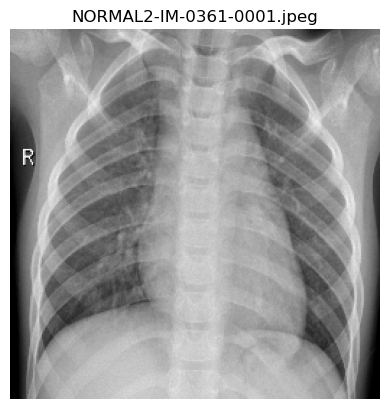

1/1 [==============================] - 0s 14ms/step
Predicted category is - D!


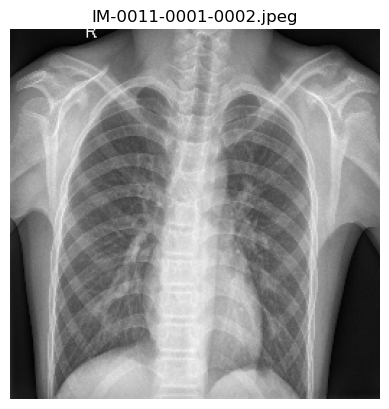

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


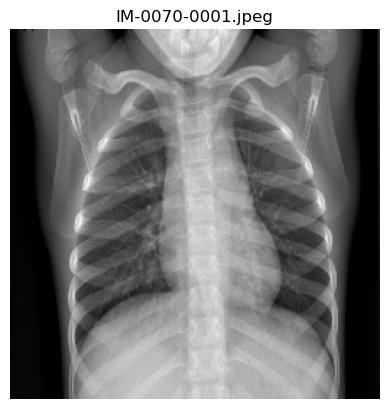

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


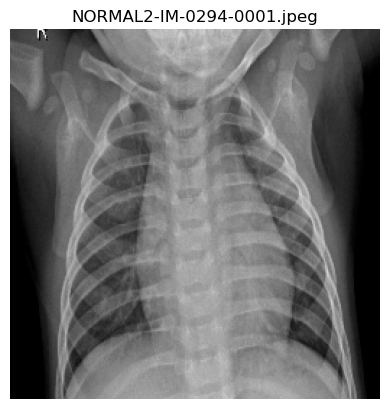

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


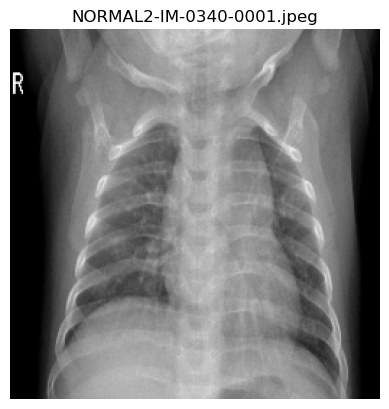

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


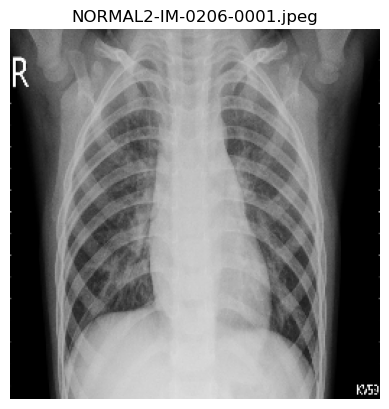

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


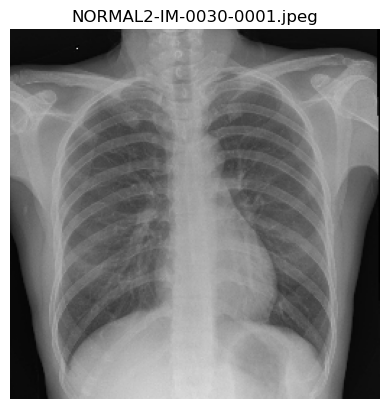

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


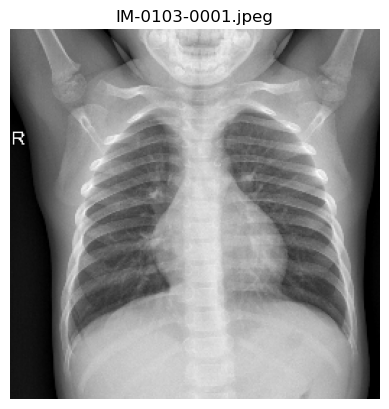

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


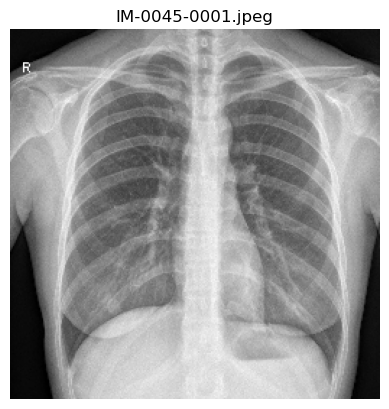

1/1 [==============================] - 0s 16ms/step
Predicted category is - D!


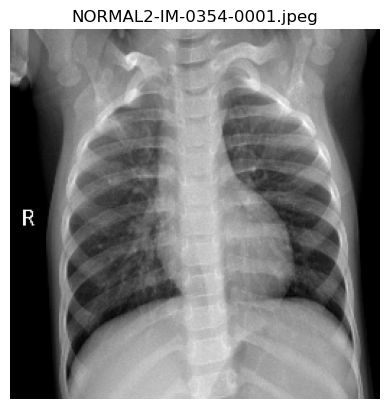

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


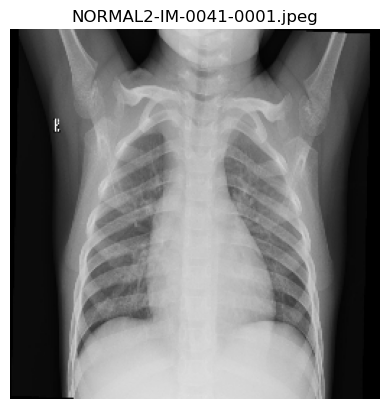

1/1 [==============================] - 0s 14ms/step
Predicted category is - D!


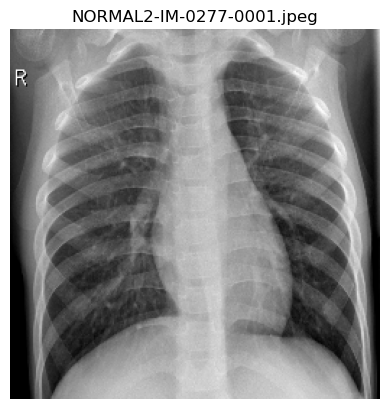

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


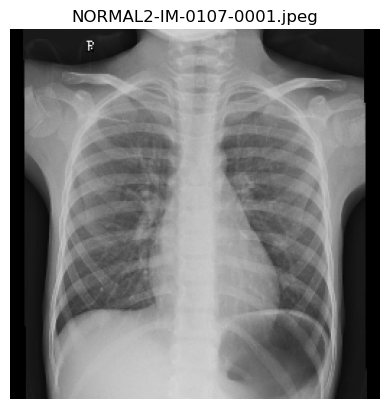

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


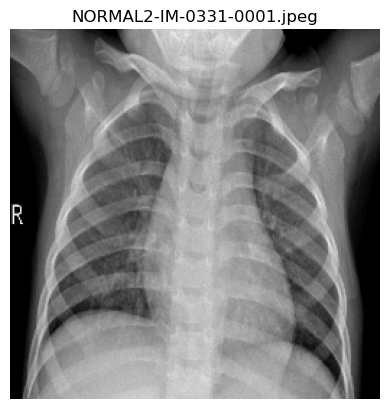

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


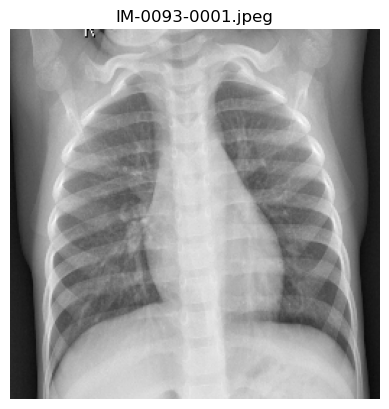

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


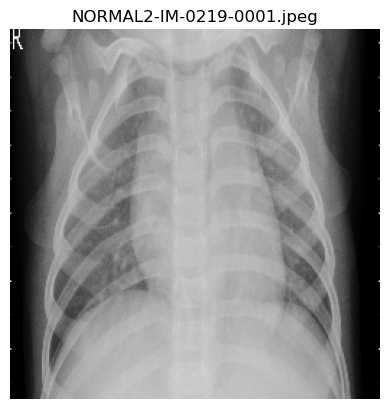

1/1 [==============================] - 0s 14ms/step
Predicted category is - D!


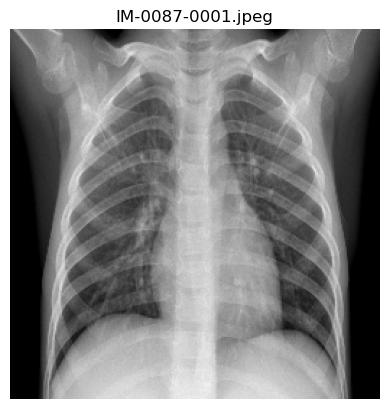

1/1 [==============================] - 0s 14ms/step
Predicted category is - D!


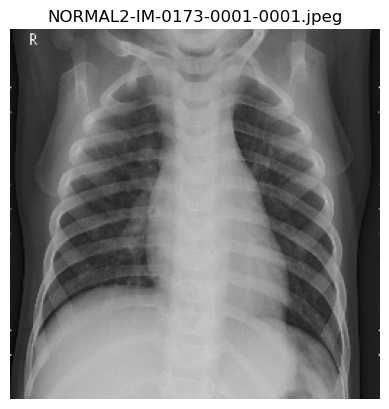

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


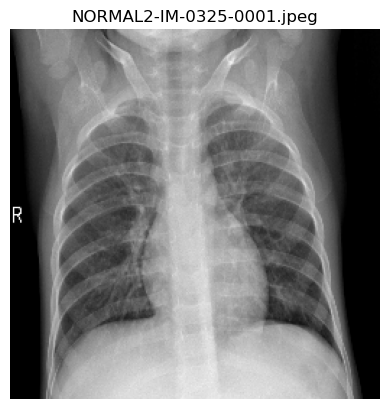

1/1 [==============================] - 0s 14ms/step
Predicted category is - A!


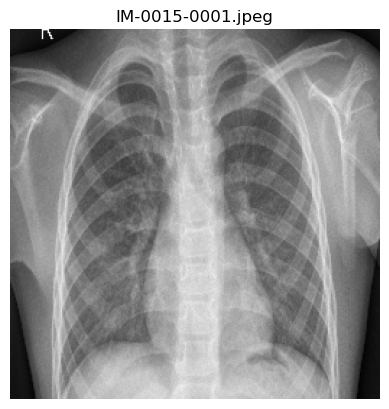

1/1 [==============================] - 0s 14ms/step
Predicted category is - D!


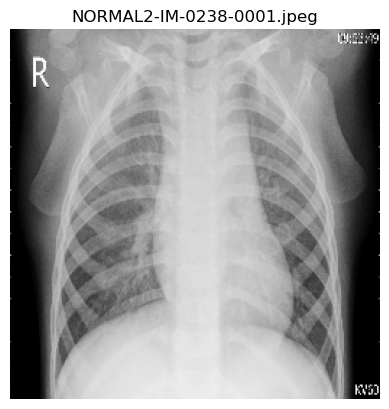

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


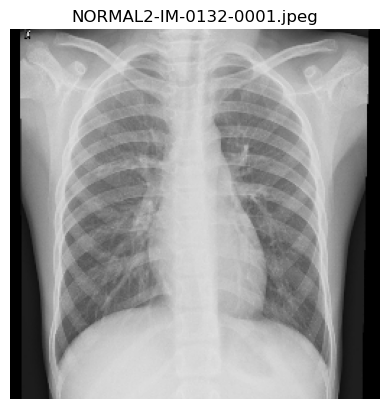

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


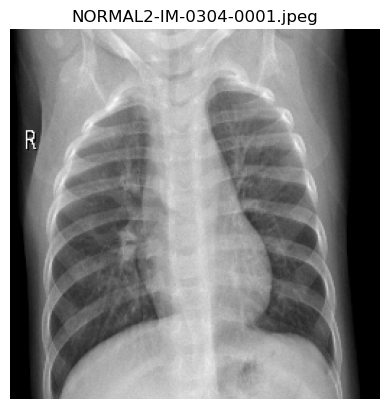

1/1 [==============================] - 0s 14ms/step
Predicted category is - D!


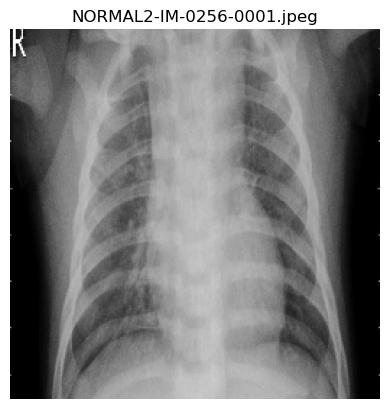

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


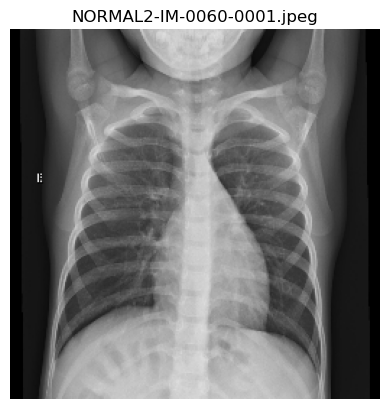

1/1 [==============================] - 0s 14ms/step
Predicted category is - A!


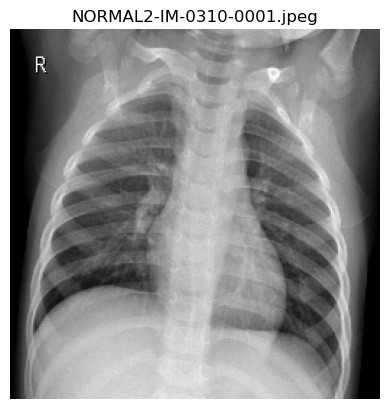

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


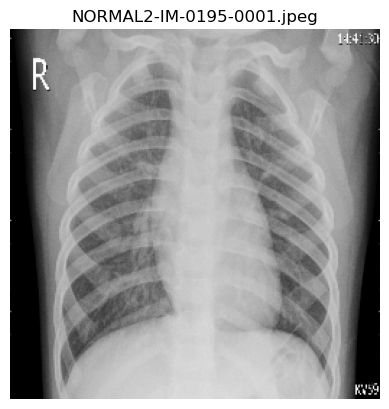

1/1 [==============================] - 0s 14ms/step
Predicted category is - D!


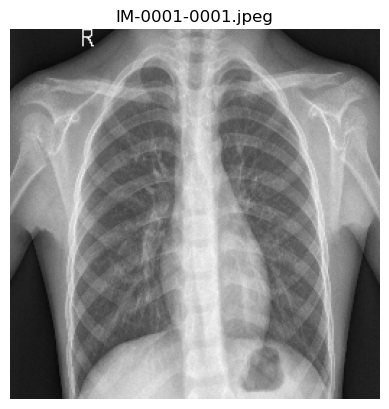

1/1 [==============================] - 0s 14ms/step
Predicted category is - D!


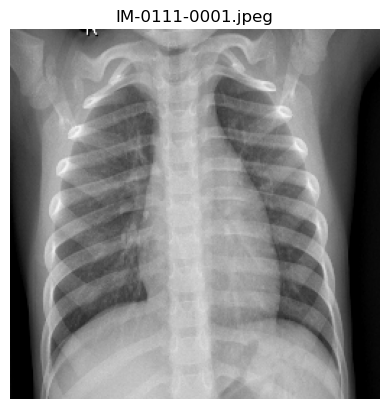

1/1 [==============================] - 0s 14ms/step
Predicted category is - D!


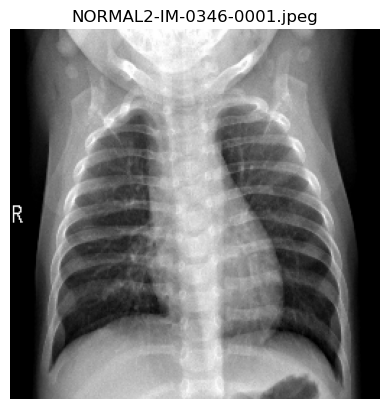

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


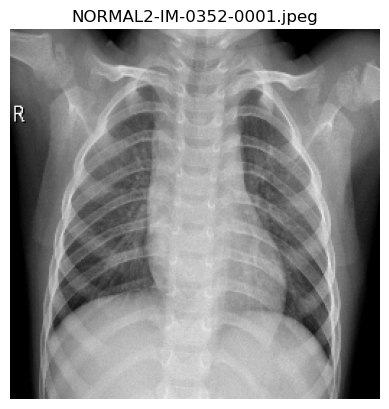

1/1 [==============================] - 0s 14ms/step
Predicted category is - A!


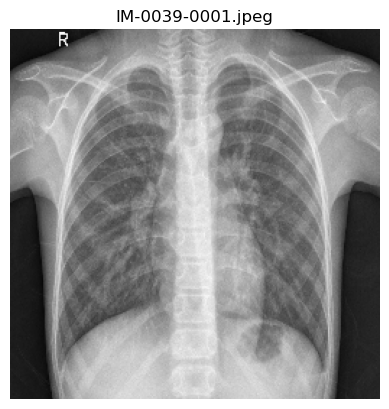

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


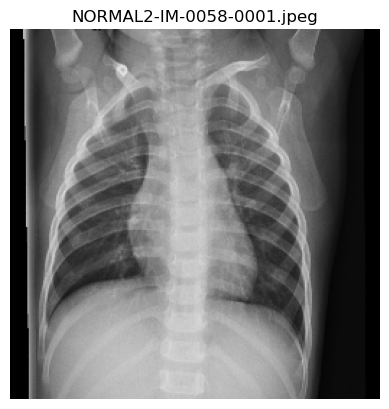

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


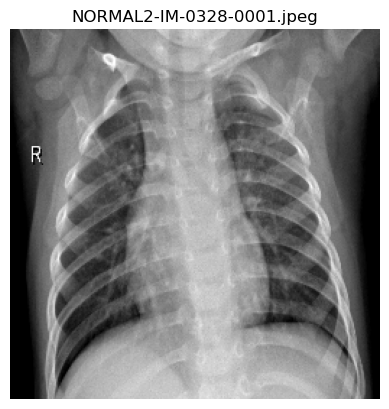

1/1 [==============================] - 0s 14ms/step
Predicted category is - D!


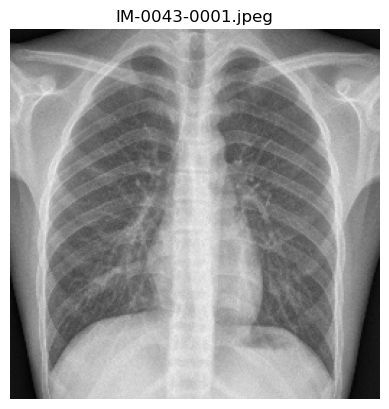

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


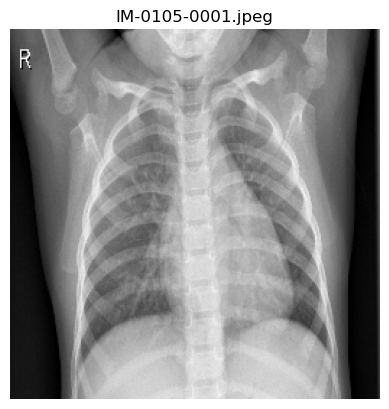

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


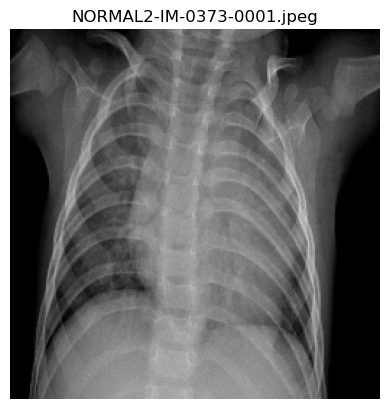

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


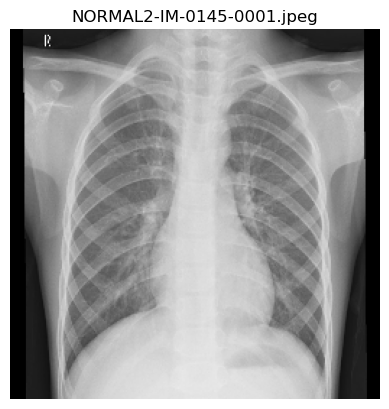

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


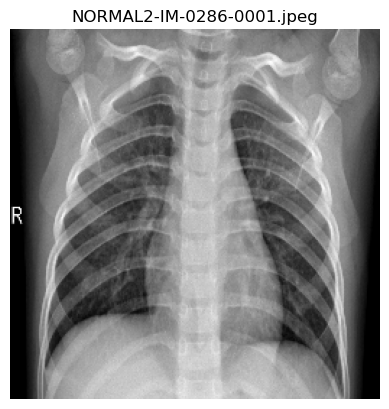

1/1 [==============================] - 0s 14ms/step
Predicted category is - A!


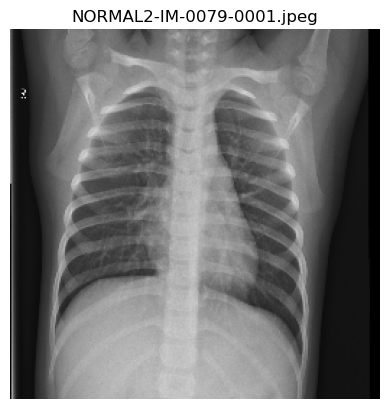

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


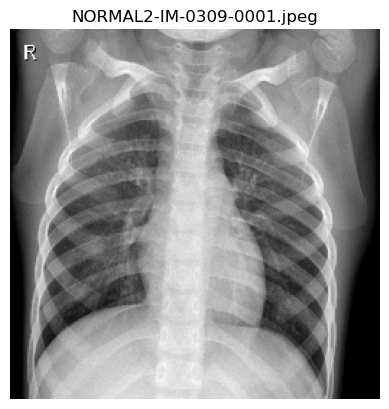

1/1 [==============================] - 0s 15ms/step
Predicted category is - A!


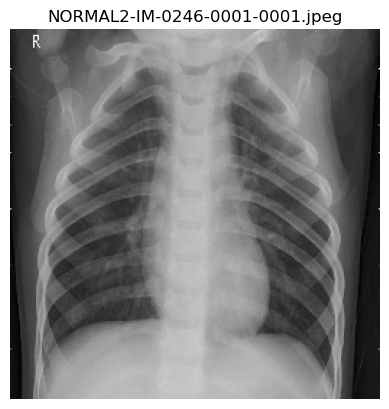

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


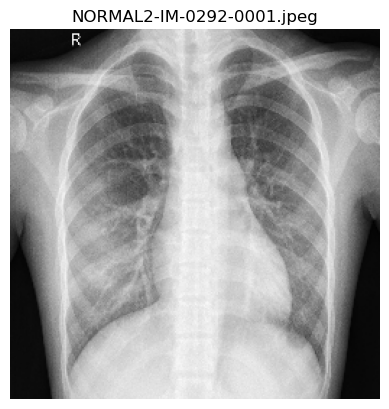

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


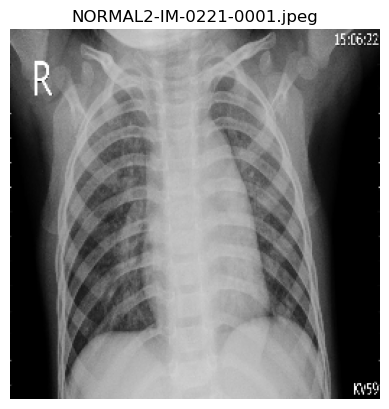

1/1 [==============================] - 0s 14ms/step
Predicted category is - D!


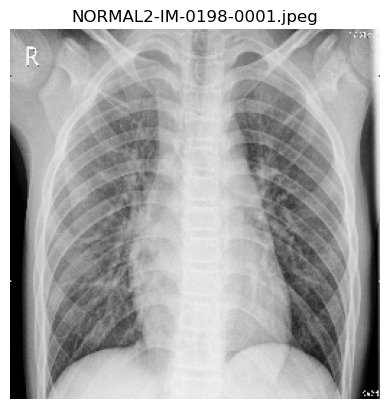

1/1 [==============================] - 0s 15ms/step
Predicted category is - D!


In [25]:
directory = "data/test/NORMAL"
file_list = os.listdir(directory)

for file in file_list:
    if file.lower().endswith(('.jpeg')):
        file_path = os.path.join(directory, file)

        img = cv2.imread(file_path)
        rgb_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        resize = tf.image.resize(rgb_img, (256,256))
        plt.imshow(resize.numpy().astype(int))
        plt.title(file)
        plt.axis('off')
        plt.show()
        
        yhat = model.predict(np.expand_dims(resize/255, 0))
        if yhat > 0.5: 
            print(f'Predicted category is - D!')
        else:
            print(f'Predicted category is - A!')


## 6. Saving the Model

In [26]:
from tensorflow.keras.models import load_model

In [27]:
model.save(os.path.join('models','pneumonia_classifier.keras'))

FileNotFoundError: [Errno 2] No such file or directory: 'models/pneumonia_classifier.keras'

In [ ]:
new_model = load_model('models/pneumonia_classifier.keras')